# Qunomon利用チュートリアル

## 1.はじめに
 * 本チュートリアルでは「手書き数字の画像を入力し、数字の特定をするタスク」を題材に、Qunomonを用いてデータセット・モデル等の品質評価を行う事例を紹介します。
 * 本チュートリアルでは、[機械学習品質マネジメントリファレンスガイド](https://www.digiarc.aist.go.jp/publication/aiqm/aiqm-referenceguide-v1.2-jp.pdf)の第1.2版 9章の内容を参考にしています。
   * あくまで参考です。お手元で実際にチュートリアルを試していただけるよう、制約の弱いデータセットを対象としており、課題の細部は異なります。
   * テストベッドの使用シーンをわかりやすくつかんでいただけるよう、評価順序なども変わっております。

## 1.1.目次

 * 1.はじめに
   * 1.1.目次
   * 1.2.シナリオの概要
 * 第一部 Qunomonを用いて機械学習コンポーネントの評価
   * 2.チュートリアル用の資材準備
   * 3.データセットの準備
     * 3.1.データセットの配置
     * 3.2.データセットのダウンロードと整形
   * 4.Qunomonを用いた評価
     * 4.1.Qunomonのダウンロードとインストール
     * 4.2.Qunomonの起動
     * 4.3.AITのインストール
     * 4.4.機械学習コンポーネント（Inventory）の登録
     * 4.5.テスト仕様（Test Description）の登録
     * 4.6.評価の実行と結果確認
   * 5.品質評価を踏まえたモデルの評価
     * 5.1.モデルの精度
     * 5.2.モデルのロバスト性
     * 5.3.品質レポート作成
 * 第二部 機械学習コンポーネントの準備方法
   * 6.推論モデルの準備
     * 6.1.モデルの構築
     * 6.2. データセットの読み込み
     * 6.3.モデルの訓練
     * 6.4.モデルの検証
   * 7.敵対的訓練を取り込んだ推論モデルの準備

## 1.2.シナリオの概要

#### 1.2.1.シナリオの流れ

本シナリオでは手書き数字を撮像した画像データを入力とし、対象の数字を判別するタスクを機械学習を使って解く過程を通じてAITの使用方法を理解してもらうことそして、Qunomon（機械学習品質テストベッド）の使用方法や効果を理解してもらうことを目指します。


以降、本ノートブックでは、まず与えられたデータセット・モデルに対する一般的なQunomon使用方法を学習してもらう目的で以下のことについて解説します。
 * チュートリアル資材・データセットの準備
 * Qunomonのインストール
 * AITHubからQunomonへのAIT（テストパッケージ）の導入
 * 評価の実行
 * 評価レポートの閲覧

より具体的な内容に踏み込みたい読者に向けて、実際のデータセット・モデルの準備を伴う実行可能なチュートリアルとして、以下のことを解説します。
 * データセット準備（保存・加工）
 * モデルの構築
 * モデルの訓練

その後、データセットやモデルの加工がQunomon上での評価にどう影響するかを確認してもらいます。

#### 1.2.2.シナリオの到達目標

本シナリオの到達目標として、全シナリオを実際に手元で動作させた読者が以下の項目を実現できるようになることを目指します。
 * Qunomonのインストール・起動・基本操作
 * QunomonへのAITの導入
 * Qunomonを用いた機械学習コンポーネントの評価
 * 標準的なAITで想定される機械学習コンポーネントの保存形式の取り扱い方法

--------------------------------------------------------------------------------
# 第一部 Qunomonを用いた機械学習コンポーネントの評価
--------------------------------------------------------------------------------

## 2.チュートリアル用の資材準備
 * チュートリアル用資材をまとめた圧縮ファイルは[こちら]()からダウンロードできます。
 * Qunomon本体は[こちら](https://github.com/aistairc/qunomon/archive/refs/heads/main.zip)からダウンロードできます。

#### 2.1.ディレクトリ構成
チュートリアル用資材のzipファイルを解凍すると、下記のディレクトリ構造でデータが保存されています。
```Markdown
- best_practice_2/
  - notebooks/
    - notebook.ipynb `(このノートブック)`
  - resources/
  - poetry.lock
  - pyproject.toml
  - requirements.txt
```
 
本ノートブックの実行に必要な依存関係はpoetryで管理しています。 下記のようにpoetryをインストールし、ディレクトリ直下に.venvを生成するか、もしくはrequirements.txtを用いて好みの方法で依存関係のインストールを行ってください。
```bash
cd best_practice_1
pip install poetry
poetry config virtualenv.in-project True
poetry install
```

-----------------------------------------------------------------------------------------
## 3.データセット準備
 - シナリオは、PyTorchを使いダウンロードした、Yann LeCunらによって公開されている、MNISTデータセットを対象としたものです。MNIST データセットとは，Yann LecunらによるLeNetの研究開発において「手書き数字画像のクラス識別」に用いられ、のちにオープン化されたデータセットです。米国商務省の研究所である National Institute of Standards and Technology（NIST）が所有していたデータセットを整形し、修正して一般公開されています。
     - 出典
         - Y. Lecun, L. Bottou, Y. Bengio and P. Haffner, "Gradient-based learning applied to document recognition," in Proceedings of the IEEE, vol. 86, no. 11, pp. 2278-2324, Nov. 1998, 
         - DOI:10.1109/5.726791.
     - 本データセットは、the Creative Commons Attribution-Share Alike 3.0 licenseのもとで公開されています。
         - 本チュートリアルではデータセットの再配布は行いません。
         - 読者がチュートリアルノートブックを実行し、ダウンロードしたデータセットを取り扱う際の責任は、読者自身に帰すものとします。
         - 必ずライセンス要件を確認し、その内容に従ってデータを取り扱うことを要請します。
 - 以降、本節ではこちらのデータを今回の機械学習シナリオおよび評価に適した形式へと適宜整理します。

#### 3.1.データセットの配置

ダウンロードしたMNISTデータセットを整形し、下記のディレクトリ構造となるようにresources直下に配置します。
- best_practice_2/
    - notebooks/
        - notebook.ipynb
    - resources/
        - MNIST/
            - aug_test.h5
            - aug_train.h5
            - Qunomon/
                - aug_test.h5
                - aug_train.h5


### 3.2 データセットのダウンロードと加工方法
#### 3.2.1 学習時に使用する前処理済データセット（HDF5形式）の生成


本チュートリアルでは
モデルの学習を安定させるためと学習の収束を速めるために画像データセットを[-1,1]にスケーリングします。
そして、データセットをHDF5形式で保存します。（Qunomon開発チームでは、ポータビリティの観点から評価時に用いるデータセットの保存形式に前処理済HDF5形式を推奨しています）






In [1]:
import h5py
import torchvision
import torchvision.transforms as transforms
import os
import numpy as np
# 保存先ディレクトリを設定
output_dir = '../resources/MNIST'
try:
    os.makedirs(output_dir, exist_ok=True)
except Exception as e:
    print(f"ディレクトリの作成に失敗しました: {e}")
    exit(1)

# MNISTデータのダウンロードと準備
raw_train_data = torchvision.datasets.MNIST(root='./data', train=True, download=True, transform=transforms.ToTensor())
raw_test_data = torchvision.datasets.MNIST(root='./data', train=False, download=True, transform=transforms.ToTensor())

# 前処理関数
def preprocess_image(image, target_size=(28, 28)):
    transform = transforms.Compose([
        transforms.Resize(target_size) if target_size != (28, 28) else transforms.Lambda(lambda x: x),
        transforms.Normalize((0.5,), (0.5,))
    ])
    return transform(image)

# HDF5形式に保存する関数
def save_to_hdf5(dataset, h5_filename,x_name,y_name, target_size=(28, 28)):
    file_path = os.path.join(output_dir, h5_filename)
    try:
        with h5py.File(file_path, 'w') as h5_file:
            images = h5_file.create_dataset(x_name, (len(dataset),1, *target_size), dtype='float32',compression='gzip')
            labels = h5_file.create_dataset(y_name, (len(dataset),), dtype='int64',compression='gzip')
            batch_size =100
            image_batch=[]
            label_batch =[]
            
            for i, (image, label) in enumerate(dataset):
                processed_image = preprocess_image(image, target_size)

                # 前処理後の画像の検証
                if processed_image is None or not processed_image.numpy().shape:
                    print(f"処理された画像が不正です。インデックス: {i}")
                    continue
                image_batch.append(processed_image.numpy().reshape(1, *target_size))
                label_batch.append(label)

                if (i+1)% batch_size ==0 or (i+1)==len(dataset):
                    images[i+1-batch_size:i+1]=np.array(image_batch)
                    labels[i+1-batch_size:i+1]=np.array(label_batch)
                    image_batch.clear()
                    label_batch.clear()
                    
        # ファイルが存在するか確認
        if os.path.exists(file_path):
            print(f"データが {file_path} に保存されました。")  # 成功メッセージ
        else:
            print(f"ファイル保存に失敗しました: {file_path}")
    except Exception as e:
        print(f"{file_path} の保存中にエラーが発生しました: {e}")

# データの保存
save_to_hdf5(raw_train_data, 'aug_train.h5','train_image','train_label')
save_to_hdf5(raw_test_data, 'aug_test.h5','test_image','test_label')



Failed to download (trying next):
HTTP Error 403: Forbidden



100.0%


Extracting ./data\MNIST\raw\train-images-idx3-ubyte.gz to ./data\MNIST\raw

Failed to download (trying next):
HTTP Error 403: Forbidden



100.0%


Extracting ./data\MNIST\raw\train-labels-idx1-ubyte.gz to ./data\MNIST\raw

Failed to download (trying next):
HTTP Error 403: Forbidden



100.0%


Extracting ./data\MNIST\raw\t10k-images-idx3-ubyte.gz to ./data\MNIST\raw

Failed to download (trying next):
HTTP Error 403: Forbidden



100.0%


Extracting ./data\MNIST\raw\t10k-labels-idx1-ubyte.gz to ./data\MNIST\raw

データが ../resources/MNIST\aug_train.h5 に保存されました。
データが ../resources/MNIST\aug_test.h5 に保存されました。


#### 3.2.2 Qunomonでの評価に備えた前処理済データセット（HDF5形式）の生成

この状態で使用することもできますが、今回はモデルの評価の時間短縮のため、訓練時に使ったデータセットのサイズを削減します。サンプルの抽出方法は層化抽出法で行います。

In [2]:
import h5py
import os


# 保存先ディレクトリを設定
output_dir = './../resources/MNIST/Qunomon'
try:
    os.makedirs(output_dir, exist_ok=True)
except Exception as e:
    print(f"ディレクトリの作成に失敗しました: {e}")
    exit(1)

train_file_path="../resources/MNIST/aug_train.h5"
test_file_path="../resources/MNIST/aug_test.h5"
import torch
from torch.utils.data import DataLoader ,random_split,TensorDataset
import h5py

def load_h5_data(h5_filename,x_name,y_name):
    """
    h5形式のデータセットからデータセットを作成する
    parameter:
        h5_filename:ファイルのパス
        x_name:ファイル内にある画像データセットの名前
        y_name:ファイル内にある正解ラベルデータセットの名前
        batch_size:バッチサイズ
    return:
        dataset:データ
    
    """
    with h5py.File(h5_filename,'r') as h5_file:
        images = h5_file[x_name][:]
        labels = h5_file[y_name][:]
    images = torch.tensor(images,dtype=torch.float32)
    labels = torch.tensor(labels,dtype=torch.long)
    dataset = TensorDataset(images,labels)
    return dataset
#データセットの読み込み
train_dataset = load_h5_data(train_file_path,'train_image','train_label')
test_dataset = load_h5_data(test_file_path,'test_image','test_label')

import numpy as np
from sklearn.model_selection import StratifiedShuffleSplit
#層化抽出法でサンプルを抽出する関数
def stratified_sample(dataset, sample_size):
    labels= [label for _, label in dataset]
    strat_split = StratifiedShuffleSplit(n_splits =1, test_size=sample_size,random_state=42)
    for _, subset_idx in strat_split.split(np.zeros(len(labels)),labels):
        subset = [dataset[i] for i in subset_idx] 
    return subset
#サンプルサイズの設定
train_sample_size= 6000
test_sample_size = 1000
#サンプルの抽出
sample_train_data = stratified_sample(train_dataset,train_sample_size)
sample_test_data = stratified_sample(test_dataset,test_sample_size)


# HDF5に保存
def save_to_hdf5_qunomon(dataset, h5_filename,x_name,y_name, target_size=(28, 28)):
    file_path = os.path.join(output_dir, h5_filename)
    try:
        with h5py.File(file_path, 'w') as h5_file:
            images = h5_file.create_dataset(x_name, (len(dataset),1, *target_size), dtype='float32',compression='gzip')
            labels = h5_file.create_dataset(y_name, (len(dataset),), dtype='int64',compression='gzip')
            batch_size =100
            image_batch=[]
            label_batch =[]
            
            for i, (image, label) in enumerate(dataset):
                image_batch.append(image)
                label_batch.append(label)

                if (i+1)% batch_size ==0 or (i+1)==len(dataset):
                    images[i+1-batch_size:i+1]=np.array(image_batch)
                    labels[i+1-batch_size:i+1]=np.array(label_batch)
                    image_batch.clear()
                    label_batch.clear()
                    
        # ファイルが存在するか確認
        if os.path.exists(file_path):
            print(f"データが {file_path} に保存されました。")  # 成功メッセージ
        else:
            print(f"ファイル保存に失敗しました: {file_path}")
    except Exception as e:
        print(f"{file_path} の保存中にエラーが発生しました: {e}")

# データを保存
save_to_hdf5_qunomon(sample_train_data, 'aug_train.h5','train_image','train_label')
save_to_hdf5_qunomon(sample_test_data, 'aug_test.h5','test_image','test_label')


データが ./../resources/MNIST/Qunomon\aug_train.h5 に保存されました。
データが ./../resources/MNIST/Qunomon\aug_test.h5 に保存されました。


## 4.Qunomonを用いた評価
ここからは、準備したデータセットと、シナリオにあわせて訓練されたモデル（4.3.で配布します）をQunomonに登録し、評価結果を確認するまでの流れを解説します。 Qunomonは産業総合技術研究所が開発した機械学習コンポーネントの品質評価テストベッド（プラットフォーム）です。 オープンソースのWebアプリケーションとして開発され、Dockerを用いて構成管理が行われているため、誰でもインターネット上からダウンロードして機械学習コンポーネントの品質評価を行えます。

Qunomonは前述の通りWebアプリケーションですので、本章（特にアプリ起動以降）では、いわゆる説明書のように画面のスクリーンショットを提示しながら解説を行います。 読者の皆様は本資料を参考にしながらお手持ちのマシン上での実行をお試しください。

### 4.1.Qunomonのダウンロードとインストール
下記のWebサイト群を参考に、Qunomonのダウンロードとインストールを行ってください。
- [Qunomonランディングページ](https://aistairc.github.io/qunomon/)
- [Qunomonリポジトリ(GitHub)](https://github.com/aistairc/qunomon)

以下に一般的な手順を示しておきます。
- Qunomonのダウンロード
  - 本ドキュメントはQunomon β版に依拠して執筆されています。
  - [リリースページ(20241015_β版リリース)](https://github.com/aistairc/qunomon/releases/tag/1.0.4)よりソースコードをダウンロードし、適当なディレクトリ下に配置してください。
- 前提ソフトウェアの準備
  - QunomonはDockerを用いて構成されていますので、動作環境にはDockerが導入されている必要があります。
  - Windowsの場合は、[Docker公式の解説](https://docs.docker.com/get-docker/)等を参考に導入されてください。
    - Docker公式ドキュメントは、Windows/Mac環境へのDocker導入に際して、Docker Desktopの利用を推奨しています(2023/12月現在）。
    - Docker Desktopには商業規模・従業員規模に基づくライセンス制約が存在しますので、ご利用の際は公式ドキュメントのライセンスをご確認の上、自己責任で導入されてください。
    - Docker Desktopの導入が難しい場合は、WSL(Windows Subsystem for Linux)環境上にDockerを導入する手順がありますが、公式にはサポートされておらず、本ドキュメントでも手順の詳細についてはスコープ外とします。

### 4.2.Qunomonの起動
- [Qunomonユーザーズ・ガイド](https://github.com/aistairc/qunomon/blob/main/qunomon/doc/USER_MANUAL/doc_jp/01_Introduction/01_Introduction.md)を参照してください。
- 以下に一般的な手順を示しておきます。
  - 一行目ではソースファイルのルートからさらに一段下ったqunomonディレクトリへ遷移しています。
  - 二行目で同ディレクトリ内の `docker-compose.yaml` を参照してDockerコンテナ群を起動しています。

``` bash
cd ./qunomon/qunomon
docker-compose up -d
```

上記コマンドの実行が完了した後、Qunomon実行環境上のブラウザから`https://127.0.0.1`にアクセスすることで、アプリが起動できます。

起動時の画面の例。評価対象の機械学習コンポーネント一覧の画面にリダイレクトされますが、この時点では何も登録していないため空の表が表示されています。

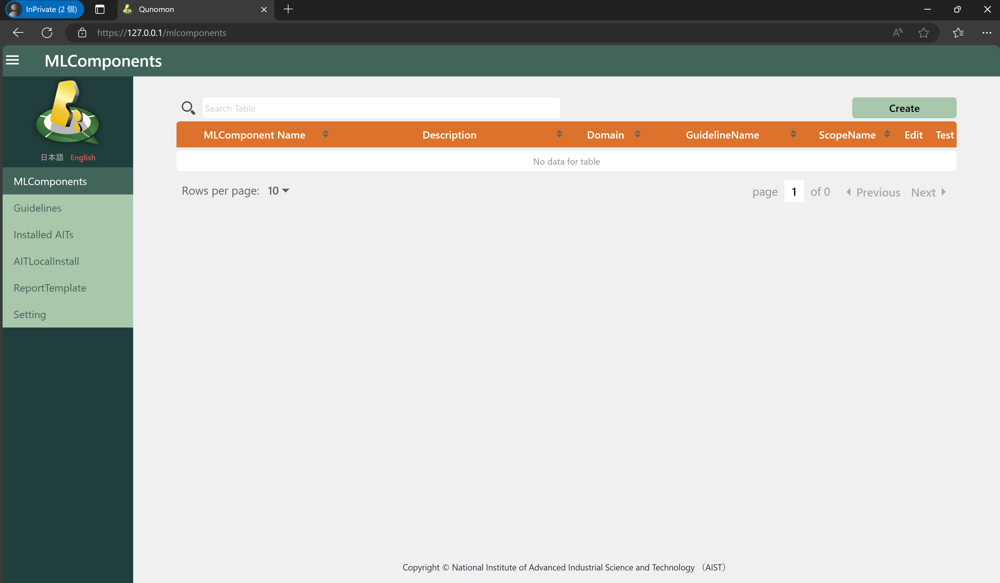

### 4.3.AITのインストール
次に、本シナリオの機械学習コンポーネント（モデルとデータセット）の評価を行うAITをインストールします。

AITは実行可能な評価手法パッケージとなっています。AITのインストール方法には、(1)産総研の運営するAIT Hubからダウンロードする方法と、(2)ローカルで開発あるいは第三者が提供しているAITをローカル環境から登録する方法があります。

本シナリオでは以降、(1)の手順を説明します。

【手順1】まずはAIT Hubとローカル環境の連携設定を行います。左ペインより「Setting」を押下し、設定画面へ移動してください。
続いて、AIT HubはGitHubアカウントを用いてユーザ認証を行いますので、AIT-HUB loginボタンを押下します。

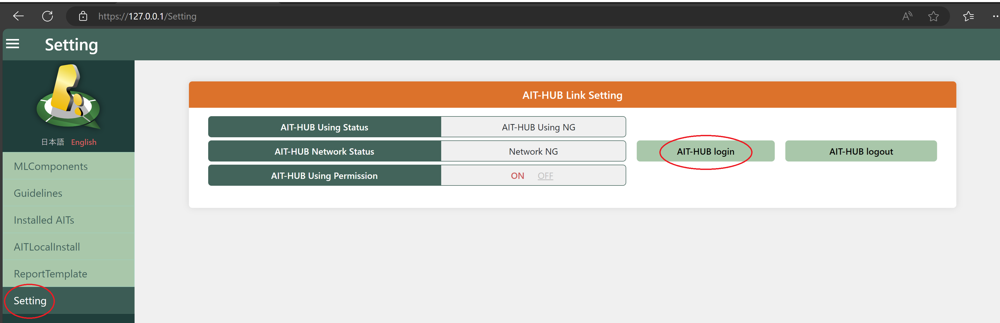

【手順2】認証画面からAITHub利用規約を確認し、<AITHub利用規約>同意しましたにチェックを入れて、GitHubアカウントでログインを実施します。

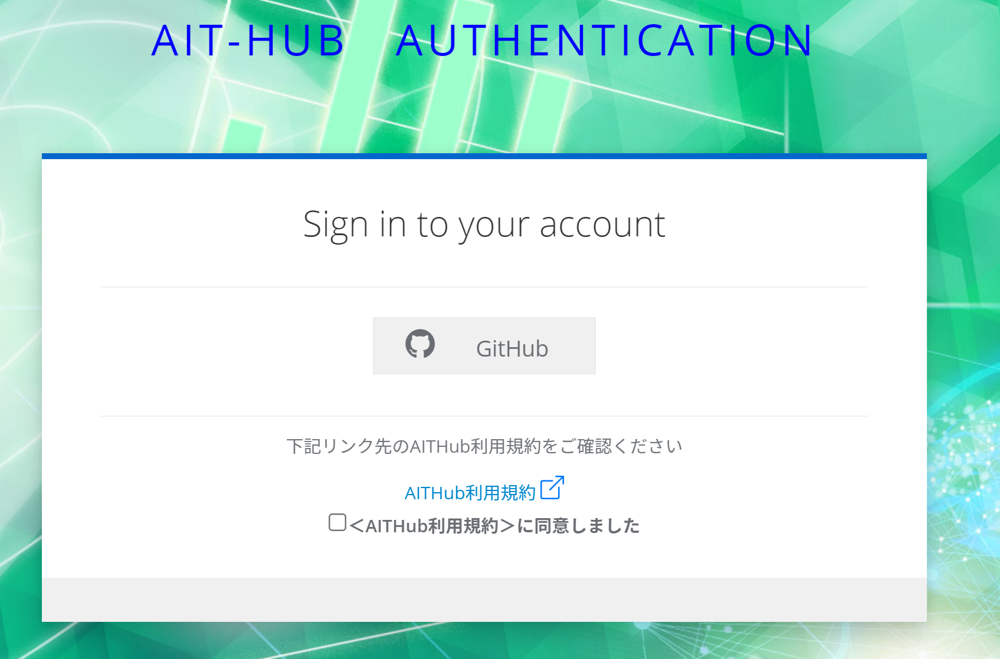    
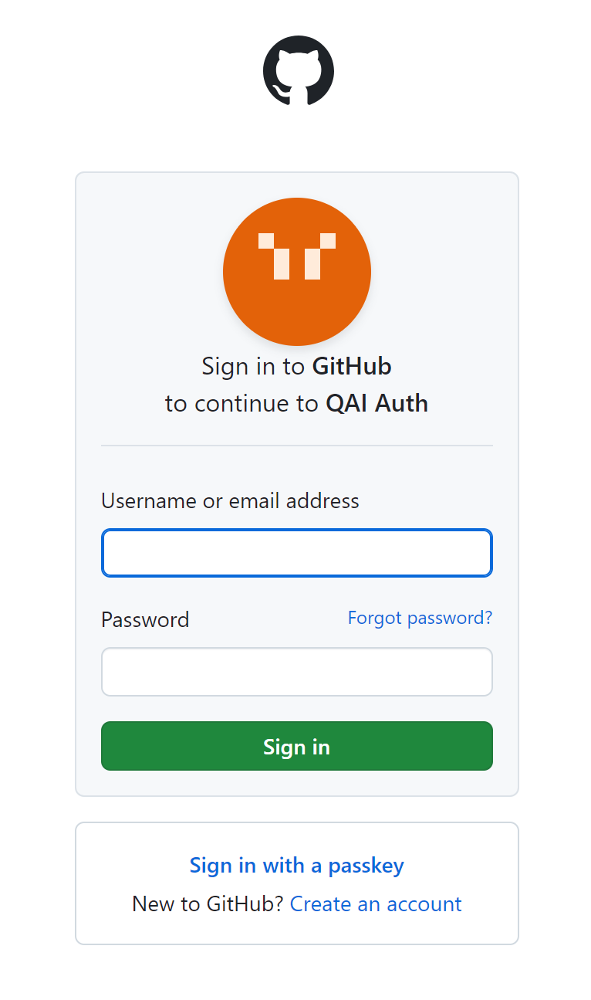

【手順3】設定画面に戻り、AIT HubからのAITインストールを許可してください。

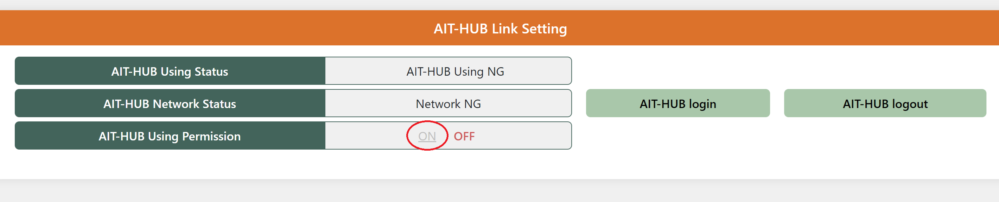

【手順4】連携が完了すると、    
AIT-HUB Using Status : AIT-HUB Using OK    
AIT-HUB Network Status : Network OK    
に変わります。

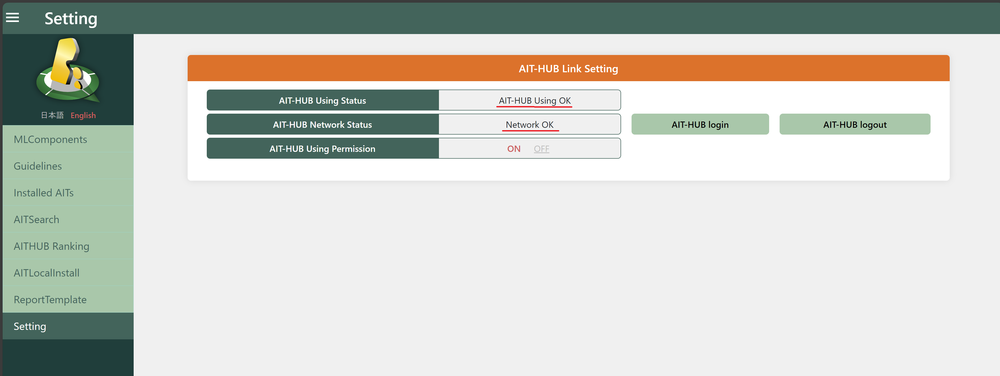

【手順5】今回はAIT Search機能を使います。
インストールするAITは、評価対象とデータ形式が一致する必要があります。
Qunomonでは"インベントリ"がデータの受け皿となり、AITとインベントリ内のデータの相互運用性を管理します。
今回は、Torchscript形式の画像分類モデルを評価しますので、検索画面に下記を入力し、Searchボタンを押下してください。    
Search Category: インベントリ情報(inventories)    
Search Keyword: TorchScript

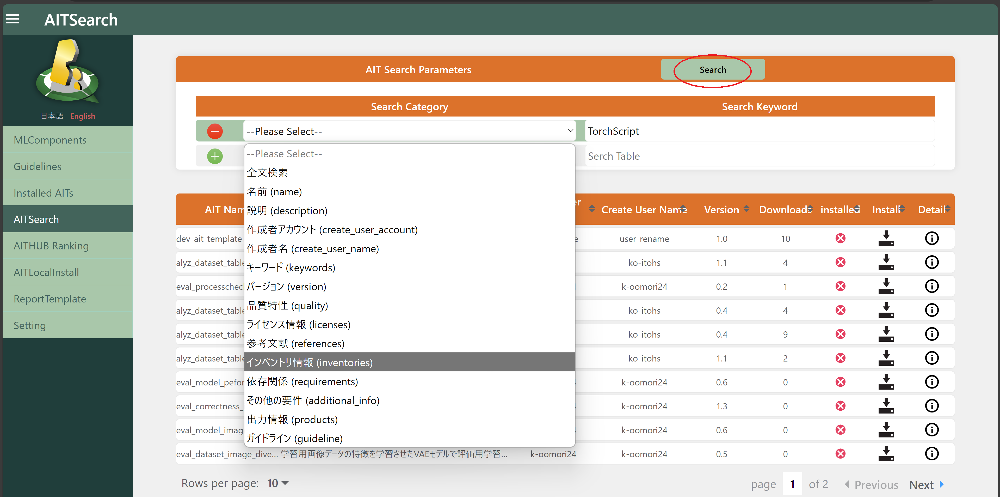

【手順6】今回はモデルのF値を確認したいので下記のAITを選択します。右のボタンでAITの詳細を確認してから、左のボタンでAITをインストールしてください。AITのダウンロード・インストールは自動的に進行し、完了後はQunomon上で選択して評価に使える状態となります。

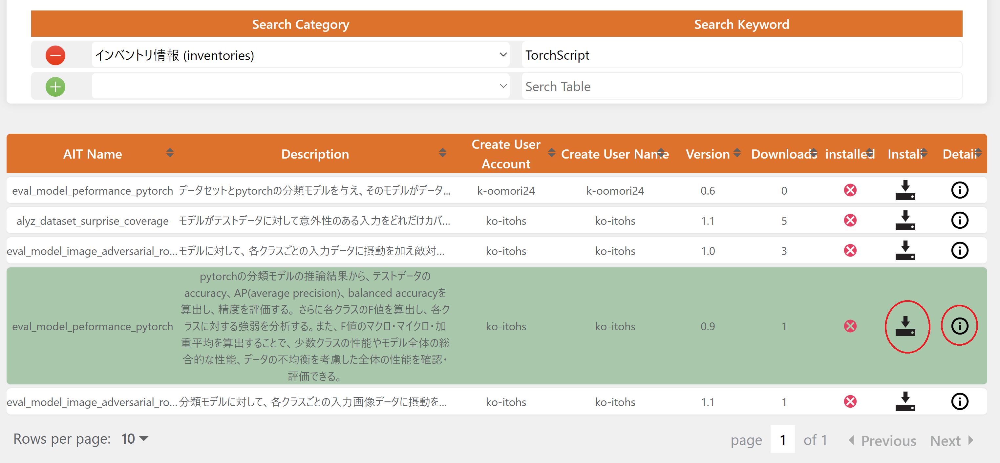

【手順7】下記の2つのAITを検索してインストールします。データセットの分布を測るためのAITは複数用意されていますが、そのうち画像の分布を評価できるものを選択します。     
Search Category:説明(description)  Search Keyword: 分布    
Search Category:キーワード(keywords)  Search Keyword: image

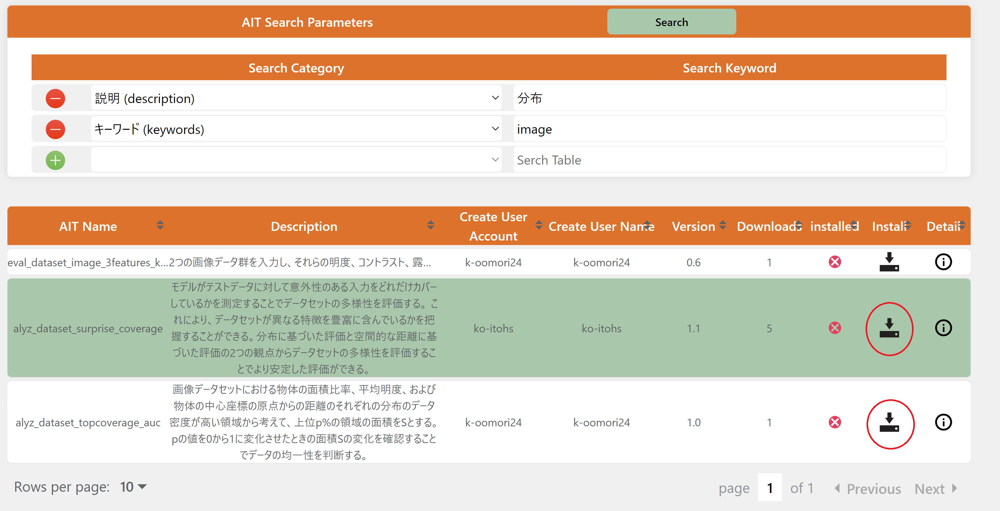

【手順8】下記のAITを検索してインストールします。モデルの安定性を測るためのAITは複数用意されていますが、そのうち画像分類モデルを評価できるものを選択します。     
Search Category:説明(description)  Search Keyword: 分類    
Search Category:キーワード(keywords)  Search Keyword: image

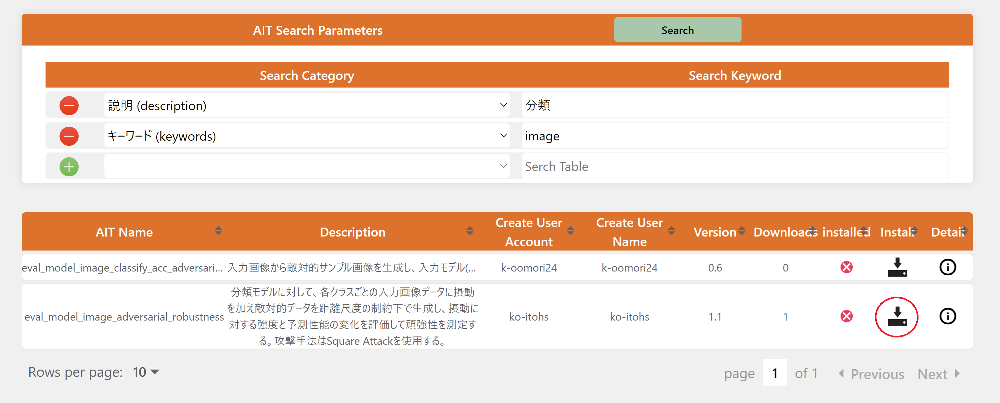

【手順9】
下記のようにInstalled AITs画面に表示されていれば成功です。

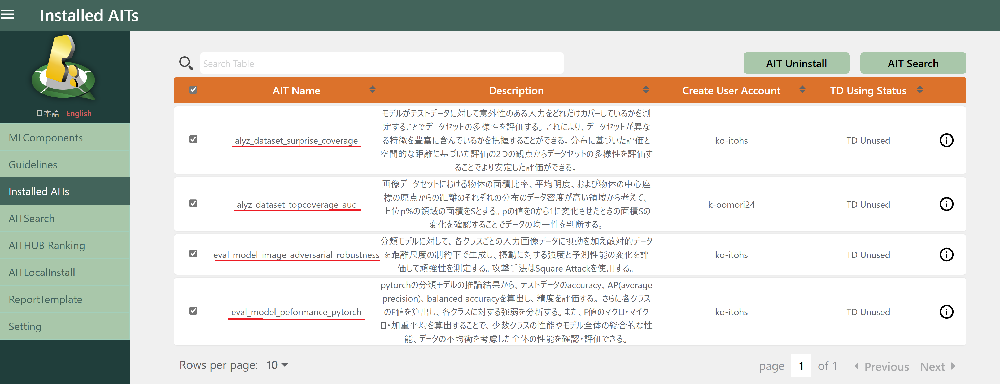

### 4.4.機械学習コンポーネント（MLComponent）の登録
- ここからは、評価対象となる機械学習コンポーネントの登録を行います。
    - 機械学習コンポーネントとは、機械学習システムで用いられる特定の機械学習を用いた機能あるいはモジュールの単位です。複数のモデルやデータセットを管理（品質評価）対象として含む場合があります。
- [MLComponent](https://127.0.0.1/MLComponents)画面へ遷移し、右上のCreateボタンから新たな機械学習コンポーネントを登録しましょう。

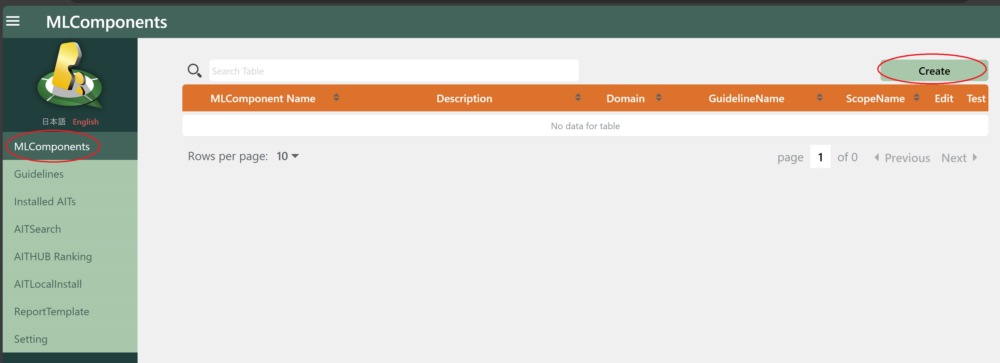

- 後から参照しやすくするため、機械学習コンポーネントの名称と説明を設定する必要があります。
    - ここでは以下の画像のように設定しておきましょう。自由記述ですがタスクのドメインは画像のクラス分類ですので、画像分類としておきます。

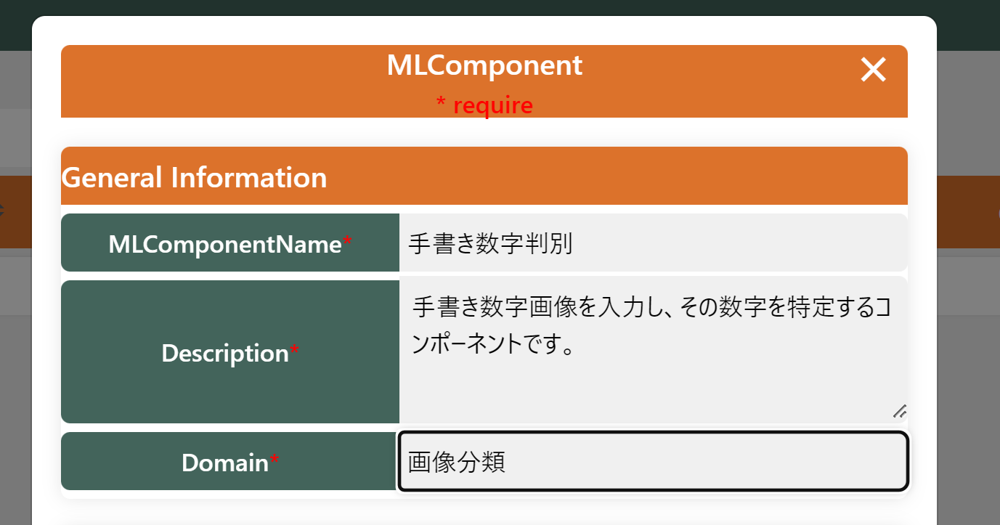

- Qunomonを用いた品質管理では、どのガイドラインや標準に従って品質評価を行っているのかを管理することで、評価観点の抜け・漏れや、ガイドライン・標準に対する適合性を管理します。
    - ここでは最初から設定されている産総研の「機械学習品質マネジメントガイドライン　第三版」を設定しておきます。
- ガイドラインがドメインやタスク種別ごとに異なる品質特性の管理を要求している場合があります。このとき、「スコープ」は今回対象とする機械学習コンポーネントについて管理すべき品質特性をまとめたものです。
    - 機械学習品質マネジメントガイドラインでは、取り扱いスコープがひとつしかありませんので、これを選択しておいてください。
    - ただし、生成系モデルや強化学習などについては今回選択したスコープ（ガイドラインの対象スコープ）の対象となっていません。あらかじめガイドラインを読んだうえで、開発中の機械学習コンポーネントがガイドラインの管理対象となるスコープに含まれるかどうかは品質評価者自身で判断するようにしてください。
- 必要事項が入力出来たらCreateボタンを押下してください。


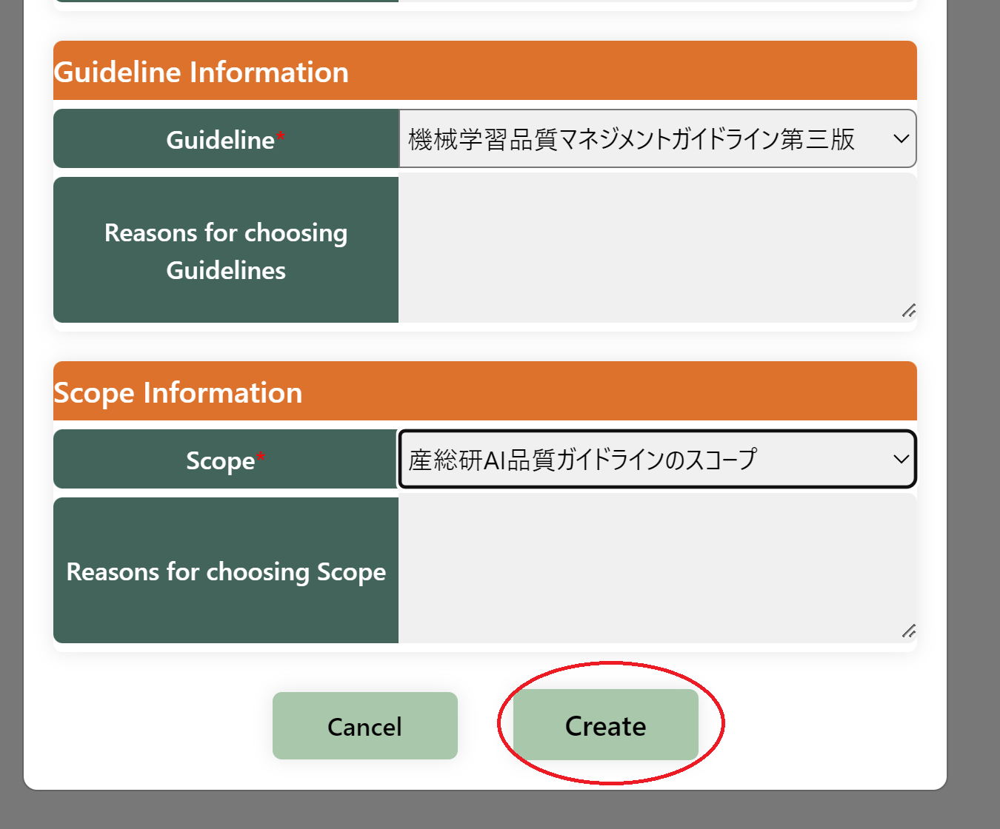

- 次の項目に進む前に、登録した機械学習コンポーネントの詳細画面に遷移しておきます。
    - 機械学習コンポーネントの詳細画面では、機械学習コンポーネントを構成する個々の資産（モデル、データセット）と、個々の資産を複数のインストール済AITで評価するテスト仕様を管理します。
    - それぞれ、個別の資産はInventory（インベントリ）、テスト仕様はTest Description（テスト・デスクリプション）という枠組みで管理が行われます。

### 4.5.テスト仕様（Test Description）の登録
- 次に、テスト仕様の登録を行います。
    - まずMLComponent画面に4.4で作成した手書き数字判別コンポ―ネントが登録されていることを確認してください。
    - 確認出来たら、右端の「テスト」列のボタンを押下し、テスト仕様登録画面へ遷移します。
    
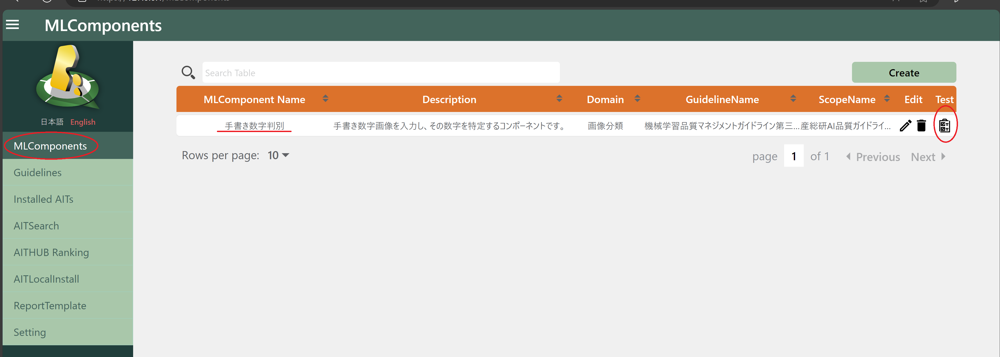
    
#### 4.5.1.テスト対象資産のインベントリへの登録
- テスト仕様を登録する前に、テスト対象資産（テストしたいデータセットやモデル）を、MLComponentのインベントリ領域に格納する必要があります。テスト時には、ここに登録されたテスト対象資産がAITから参照され、検査されます。
- 以下はテスト仕様登録画面からテスト対象資産の登録を行う手順になります。

【手順1】手書き数字判別 MLComponent のテスト仕様登録画面から Inventories を押下します。

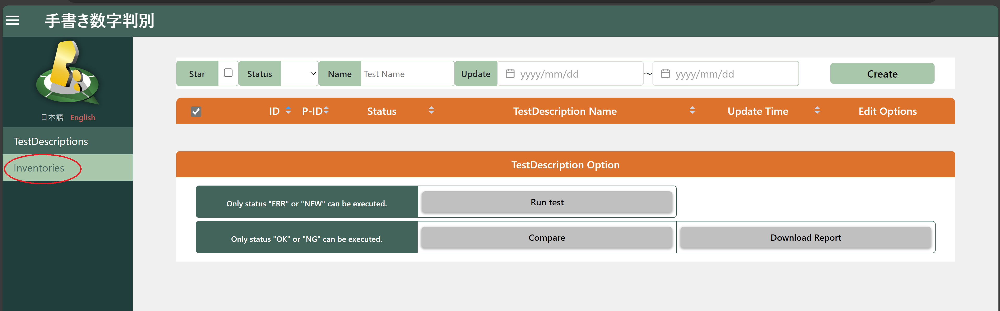

【手順2】手書き数字判別 MLComponent のインベントリ一覧画面から Create を押下します。

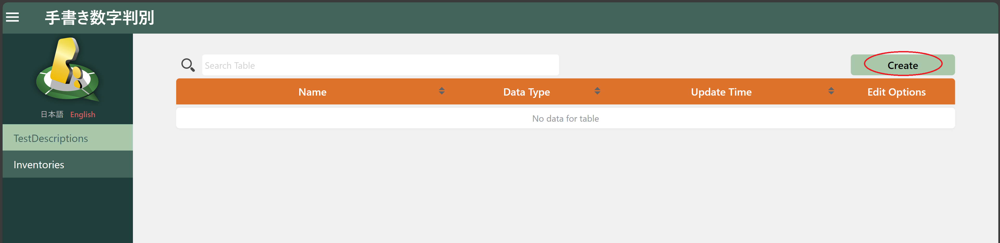

【手順3】まずはモデルを登録します。Torchscript形式に変換されたモデル (こちらからダウンロード) をPC上に配置し、Path欄にはそのファイルパスを入力してください。 Nameには他のアセットと判別しやすい名前をつけてください。DataTypeは登録する資産に適合するものを選んでください。ここではmodelとなります。Formatはファイルフォーマットです。拡張子よりpthを選択します。 ** 今回のチュートリアルと同等のモデルを訓練し、Torchscript形式で保存する方法については後述します。第二部 5章を参照してください。 **

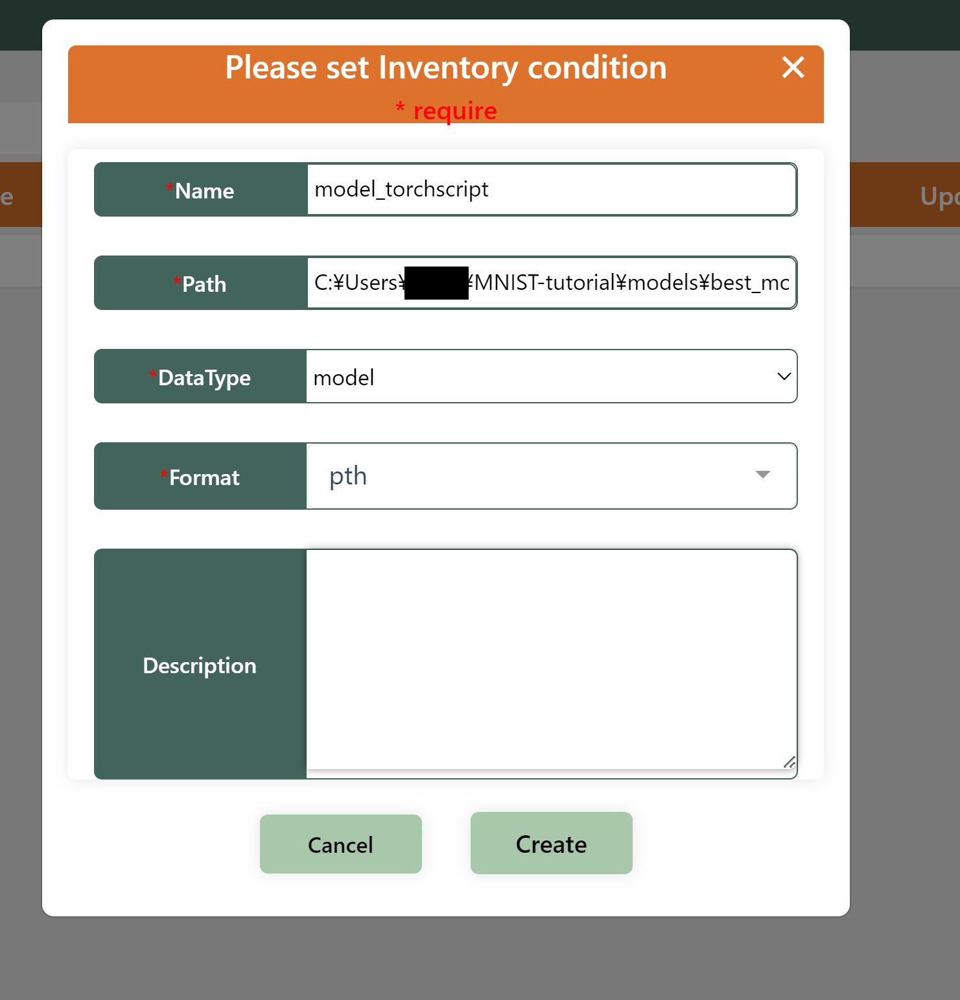

【手順4】同じくデータセットを登録します。3.2.2.節で生成したHDF5形式のデータセットのファイルパスを指定してください。 3.2.2.のコード内にコメントアウトされている通り、マシンスペックによってはテスト実行時にメモリ不足を起こす可能性があります。適宜テスト用データセットのサイズを小さくしてお試しください。

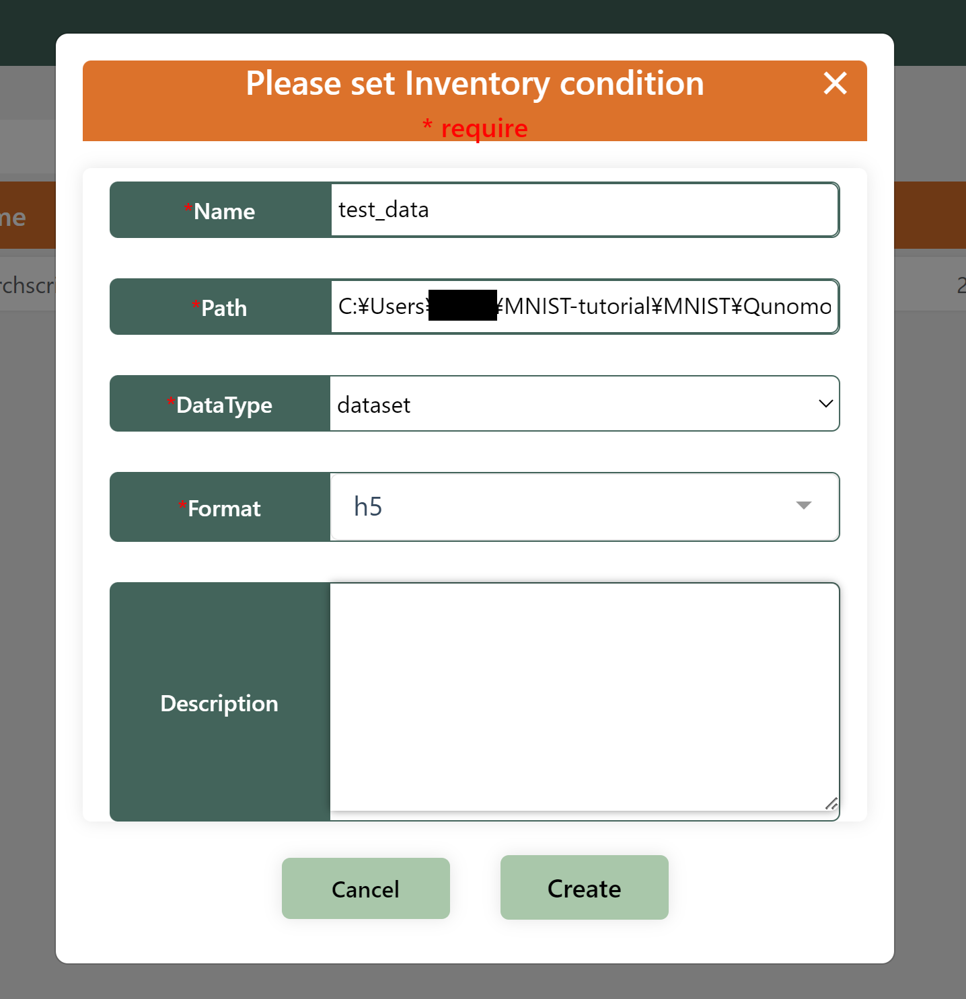

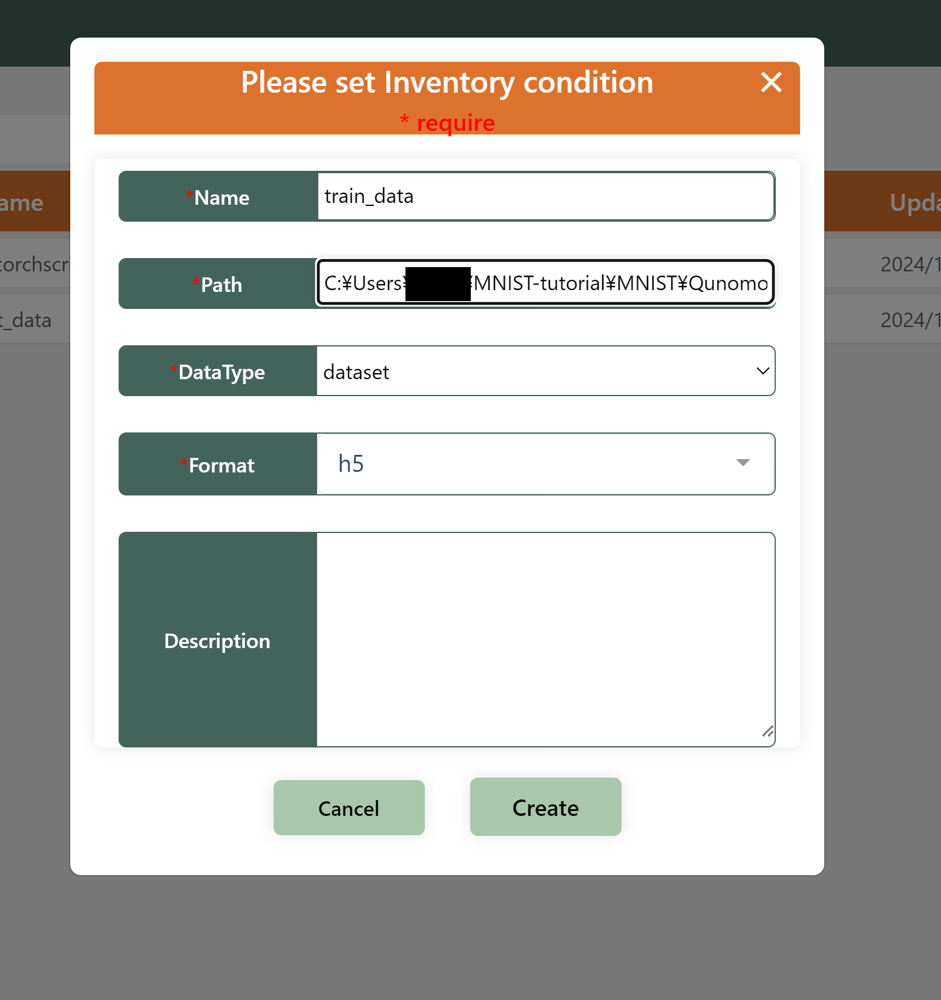

【手順5】登録が完了したら、テスト仕様登録画面に戻ってください。

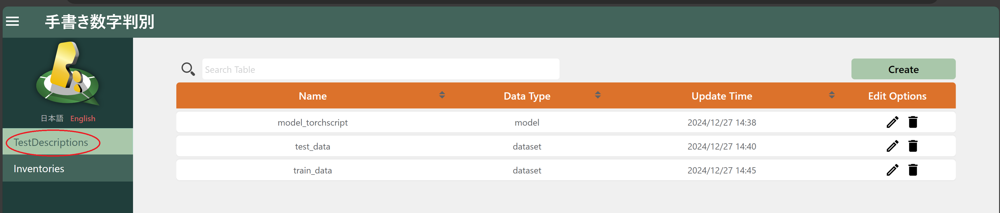

#### 4.5.2.テスト仕様の登録
- テスト仕様の登録を行います。

【手順1】テスト仕様登録画面へ遷移します。

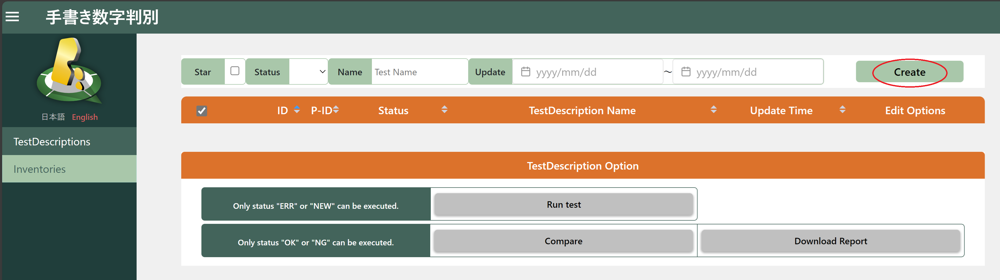

【手順2】下図の要領で必要事項を入力します。

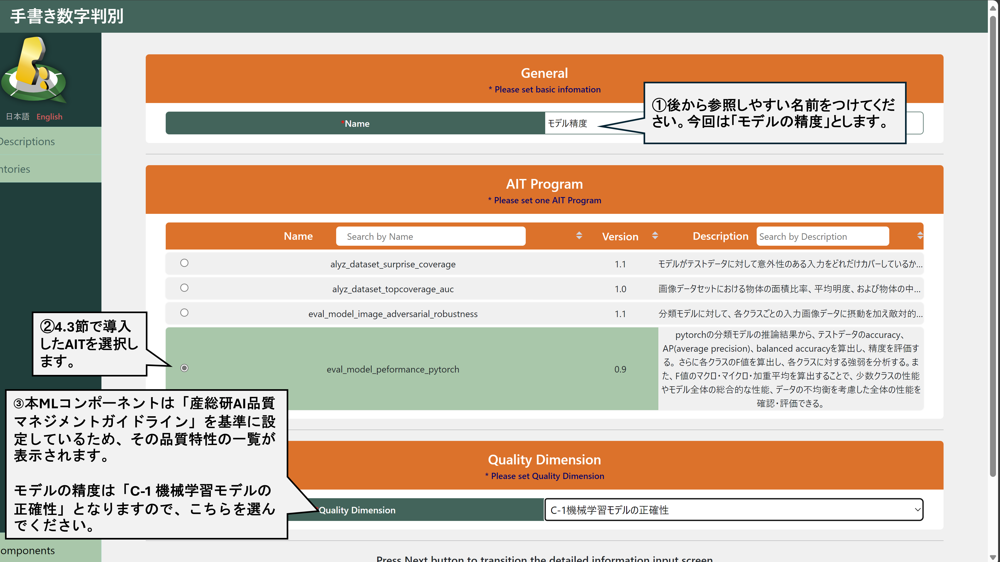

【手順3】テスト受け入れ基準を設定します。今回はテストですので、F値（F_Score_by_class）0.8以上を基準としておきます。 また、マイクロ平均でモデル全体の総合的な性能を確認する目的で、average_F_Scoreも0.8以上であることを要求することにします。

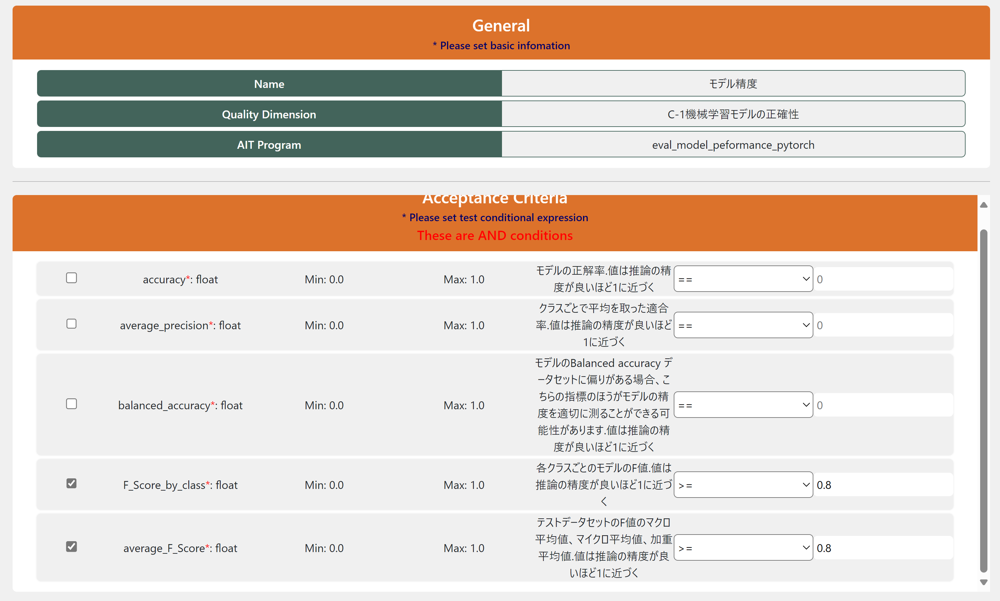

【手順3の続き】画面を下にスクロールし、AITの実行時に要求されるパラメータを入力してください。 ここでは、HDF5形式のデータセット内に、データとラベルがそれぞれなんという名前で収められているかを入力する必要があります。 我々は3.2.2節末尾でそれぞれ"test_image", "test_label"と名付けましたので、これを入力します。 また、テストで用いるデータセット・モデルを登録したインベントリと紐づけてください。 準備が完了したら、Createを押下してください。

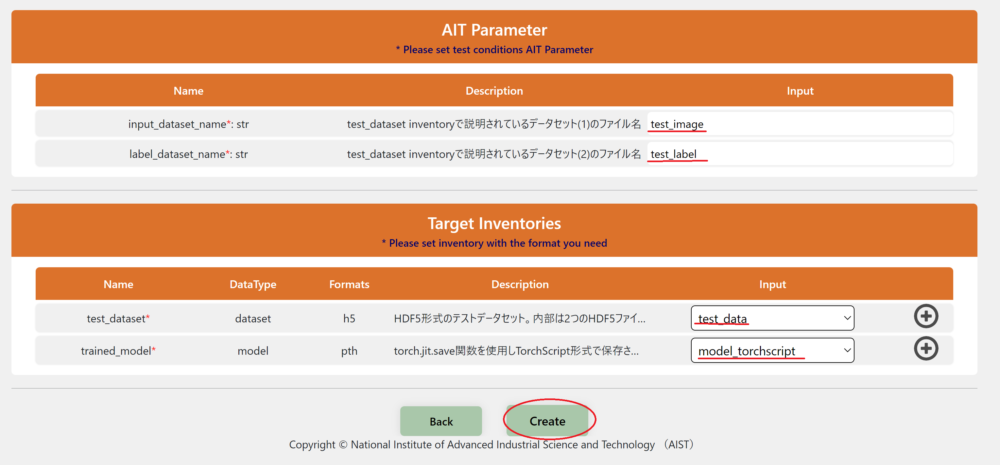

【手順4】同様に、データセットの意外性に関するテスト仕様を登録します。3.2.3.節で生成したZIP形式のデータセット群を読み込み、訓練データとテストデータ間で異なる特徴を豊富に含んでいるかを確認します。 

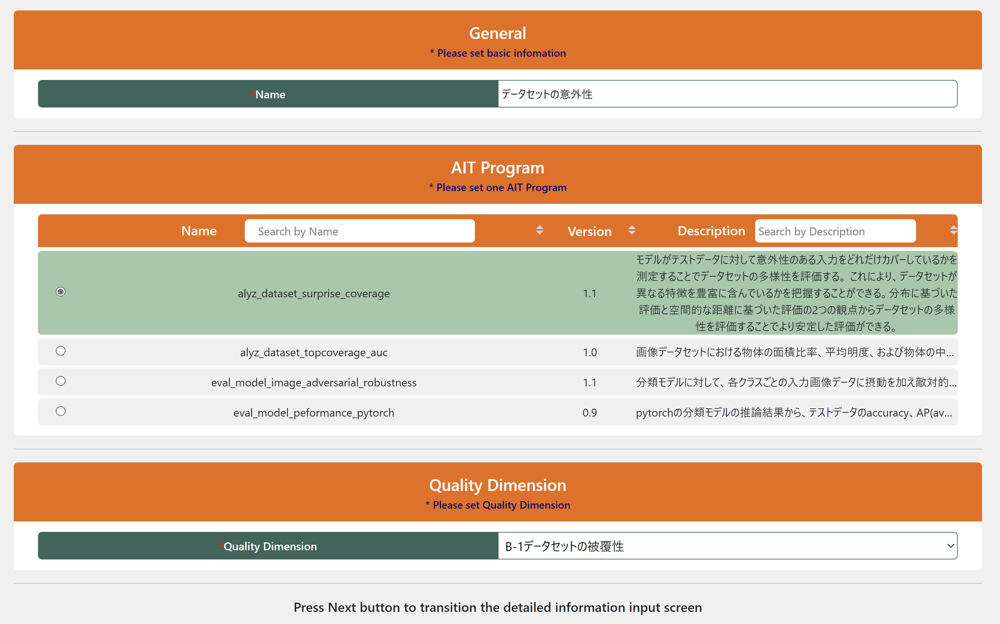

【手順4の続き】設定値は下記のようにします。モデルがテストデータに対して意外性のある入力をどれだけカバーしているかを測定することでデータセットの多様性を確認する目的で、Likelihood-based_Surprise_CoverageとDistance-based_Surprise_Coverageを0.8以上と設定しておきます。

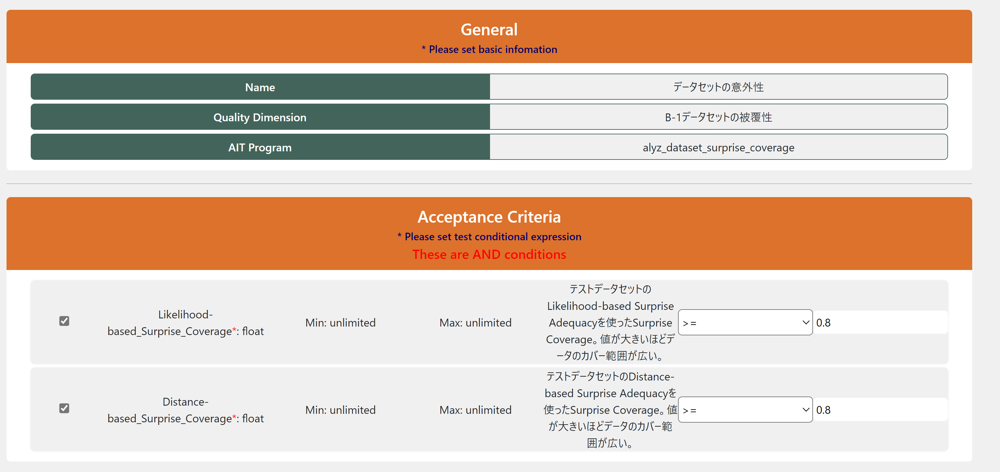

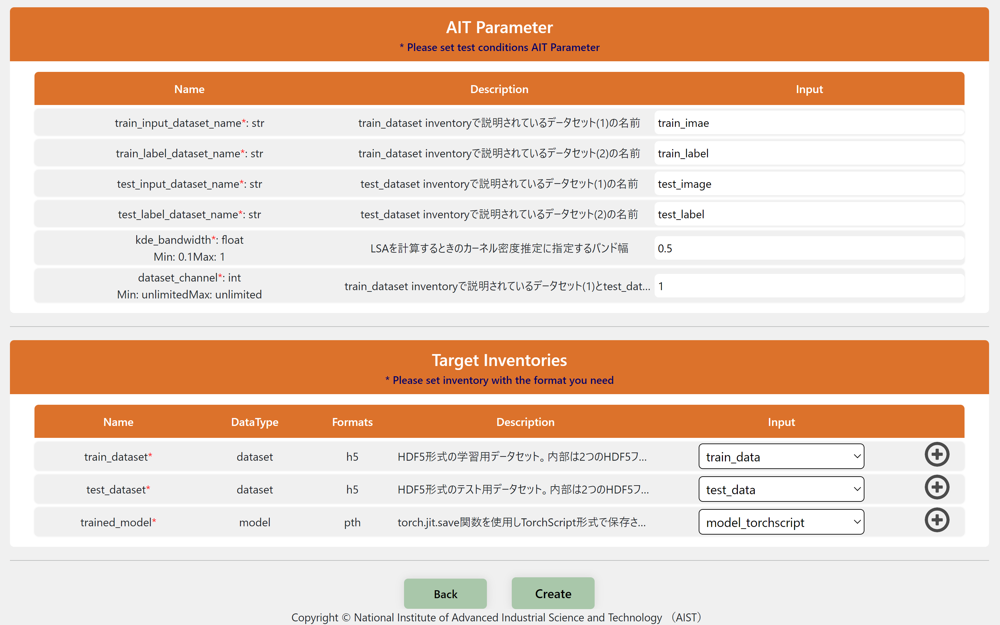

【手順5】データセットの属性値分布に関するテスト仕様を登録します。3.2.3.節で生成したZIP形式のデータセット群を読み込み、訓練データの画像の基本的な属性が均一であることを確認します。同様にテストデータでも行います。

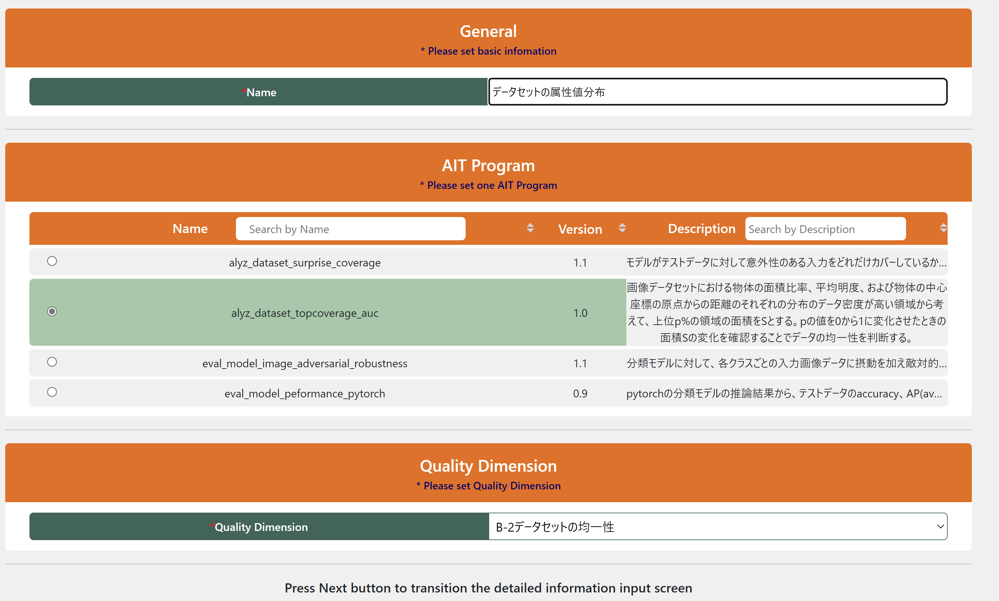

【手順5の続き】設定値は下記のようにします。物体の面積比率、平均明度、および物体の中心座標の原点からの距離はある程度均一であってほしいので、全て0.6以上と設定しておきます。

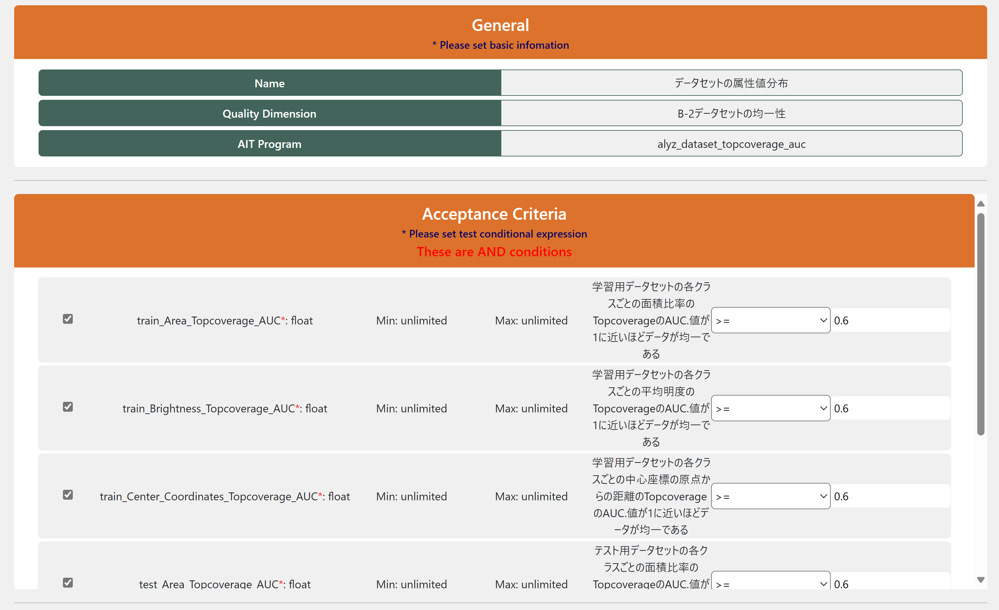

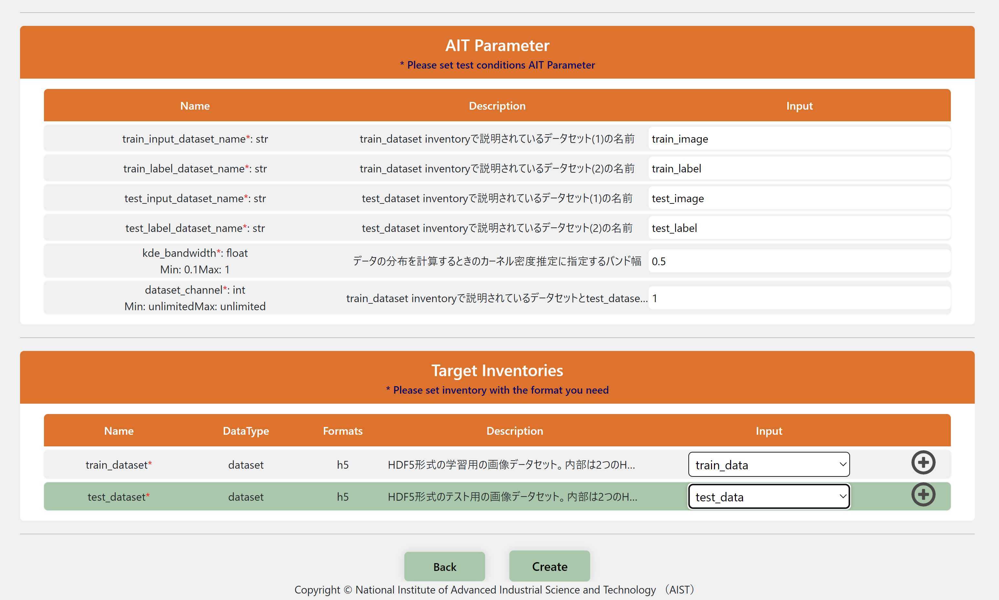

【手順6】モデルのロバスト性に関するテスト仕様を登録します。3.2.3.節で生成したZIP形式のデータセット群を読み込み、敵対的データに対してモデルが頑健であるかを確認します。

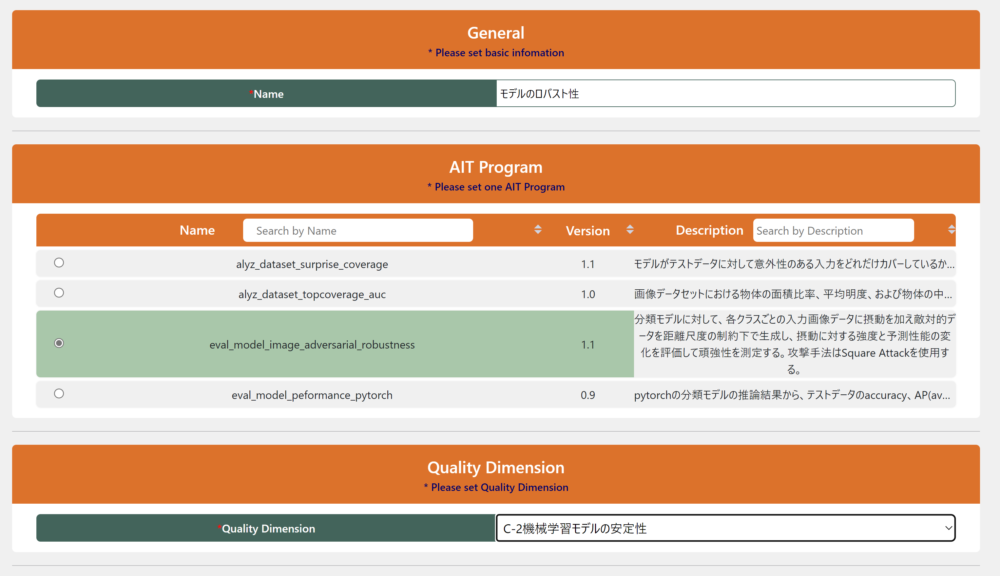

【手順6の続き】設定値は下記のようにします。今回のモデルは敵対的データに対して学習を行っていないですが、Adversarial Robustnessを1以上と設定しておきます。

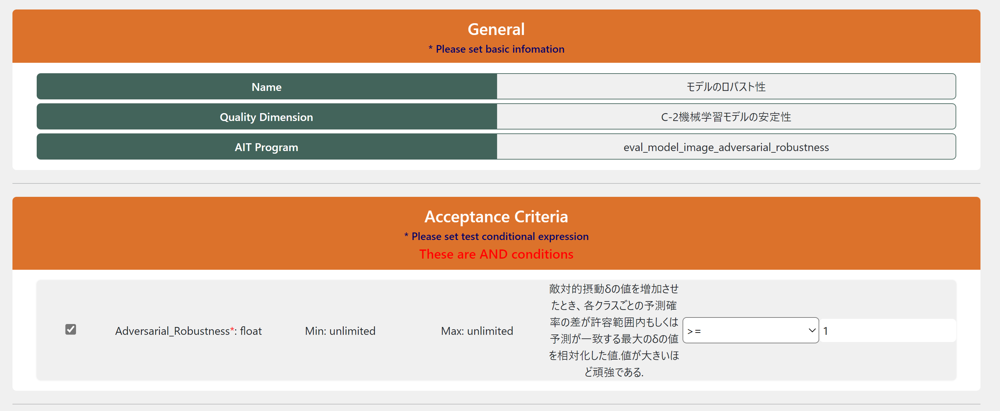

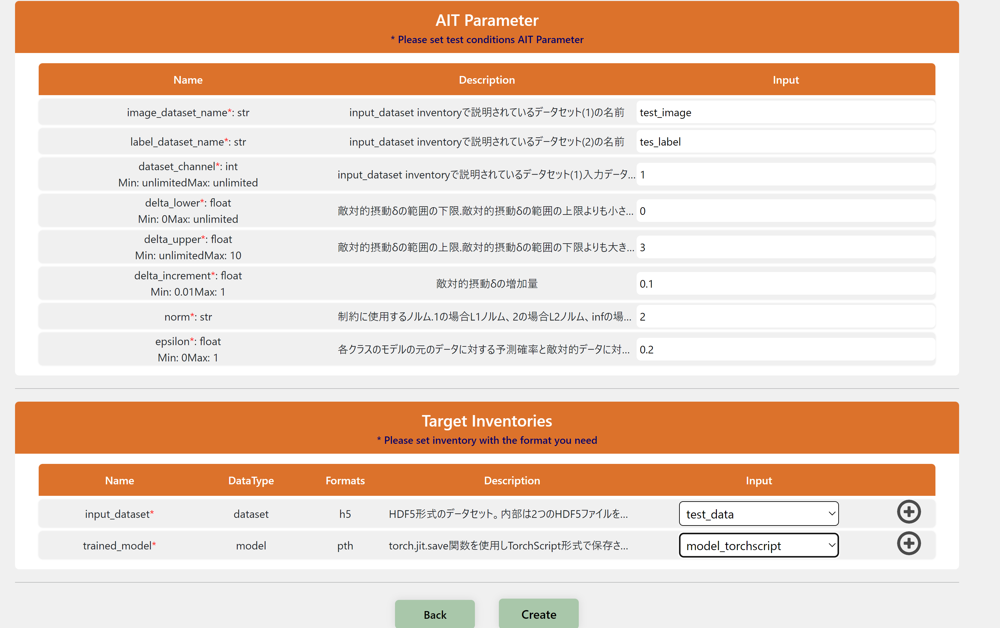

### 4.6.評価の実行と結果確認
#### 4.6.1.実行
MLコンポ―ネントのテスト仕様画面に遷移し、4.5節で設定したテスト仕様にチェックを入れて、`Run Test`を押下してください。

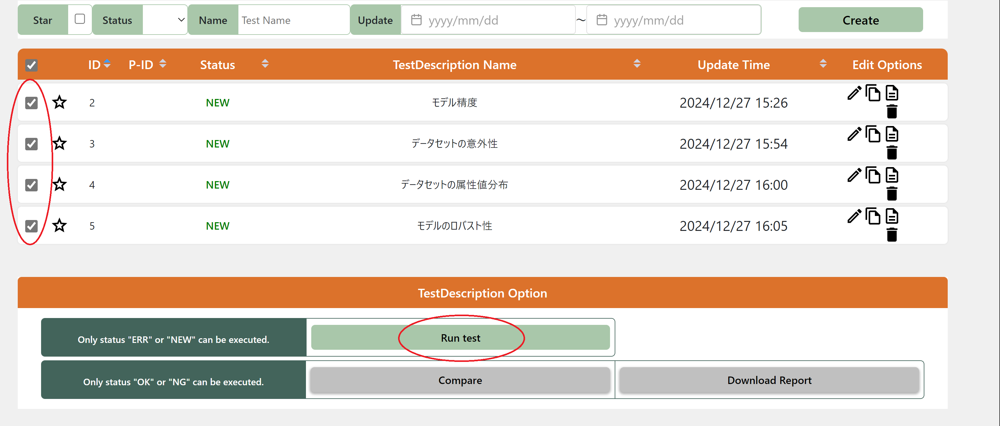

テストはリアルタイムに実行され、状況も画面上に表示されます。 図示するように、Status:DONEと表示されれば評価が完了したことを表します。 次行の評価結果のうち、「OK」はすべての受け入れ基準を満たしたことを表し、「NG」は受け入れ基準を満たさない項目があったことを表します。 ※「ERR」「NA」は実行中になんらかの問題があったことを表します。エラー発生時にはログも閲覧できます。

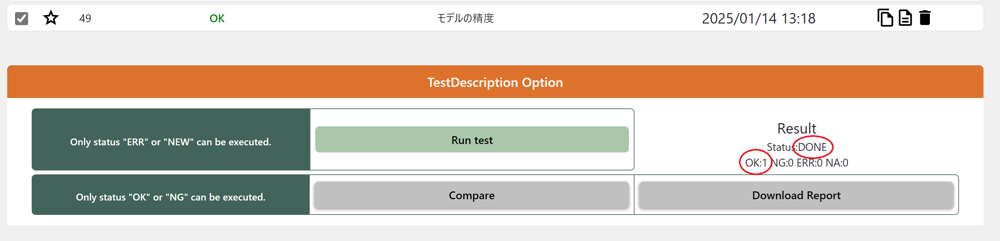

#### 4.6.2.モデルの精度の評価結果の確認
実行したテスト仕様の右列にある"detail"ボタン（資料のアイコン）をクリックすると結果の詳細を閲覧できます。 この画面であなたのテスト結果に対する見解を入力してください。 テスト結果が「OK」であることは、設定した受け入れ基準することを表しますが、最終的には人間が評価の実行結果を確認して判断する仕組みになっています。 以降はテスト結果画面の説明になります。

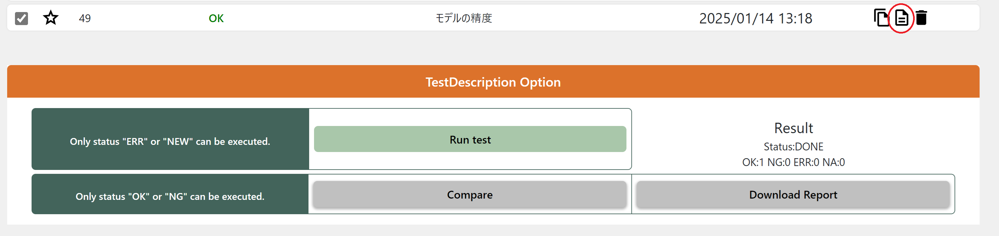

左上の領域ではAITが出力した参考情報（画像など）が出力されます。 このAITはクラスごとのF値、再現率、適合率の表が出力されますので、各クラスのF値を確認しどのクラスに対してモデルが弱いかを確認してください。また混同行列も出力されますので参考に見ておきましょう。今回はデータのサンプルサイズを削減しているので、元のテストデータに対する評価ではない事を考慮する必要があります。後述する見解欄にその旨を記録しましょう。

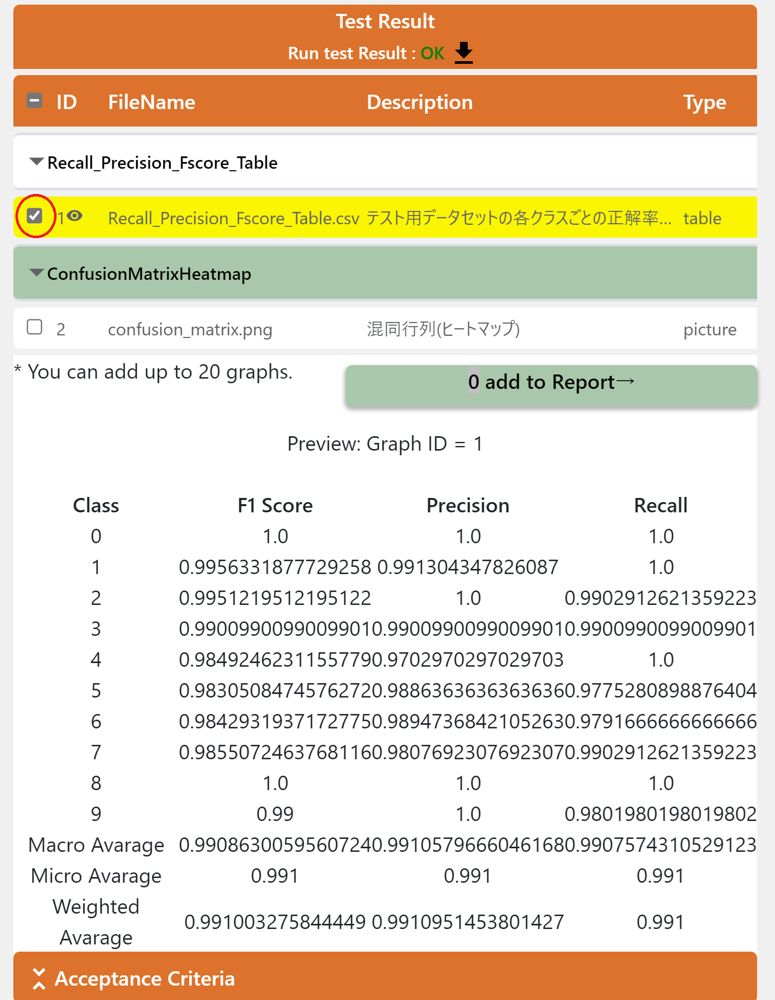

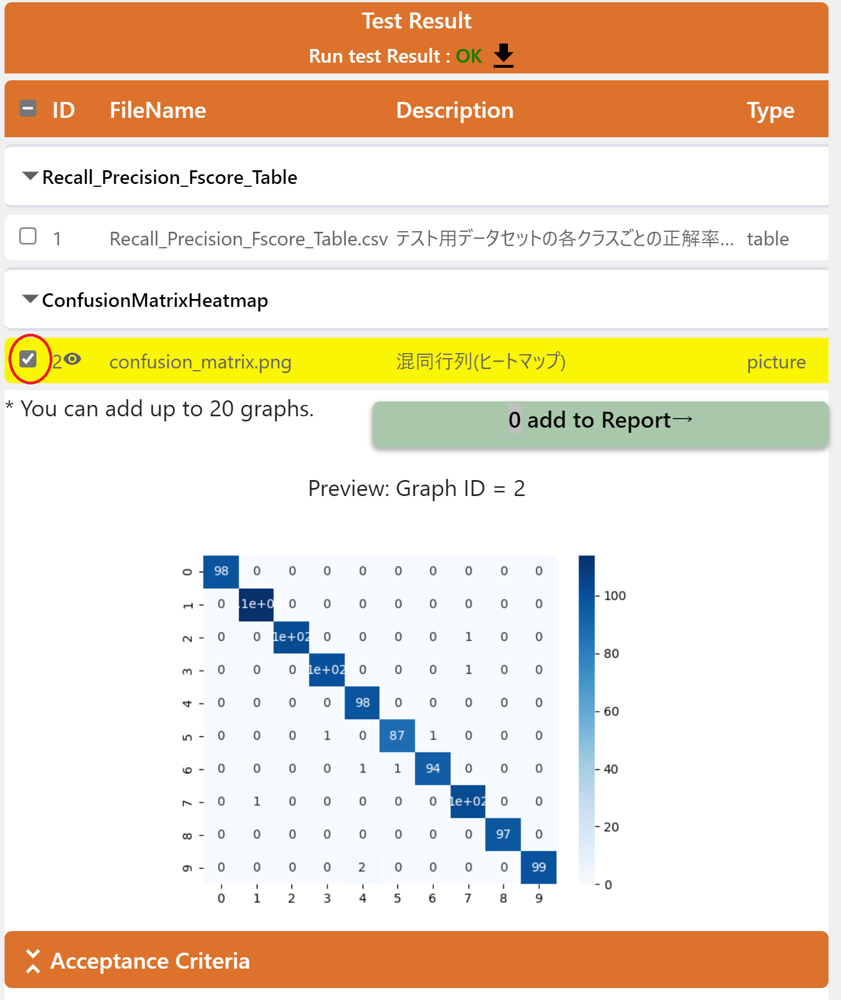

この領域にはテスト結果の正確な値が表示されています。 Measurementに計測値が、Descriptionにその説明が、そしてConditionに設定した受け入れ基準が表示されています。表示しきれていない部分はスクロールして確認できます。今回は各クラスのF値の要件も、F値のマイクロ平均の要件も満たしているため、この観点では問題ないと考えられます。

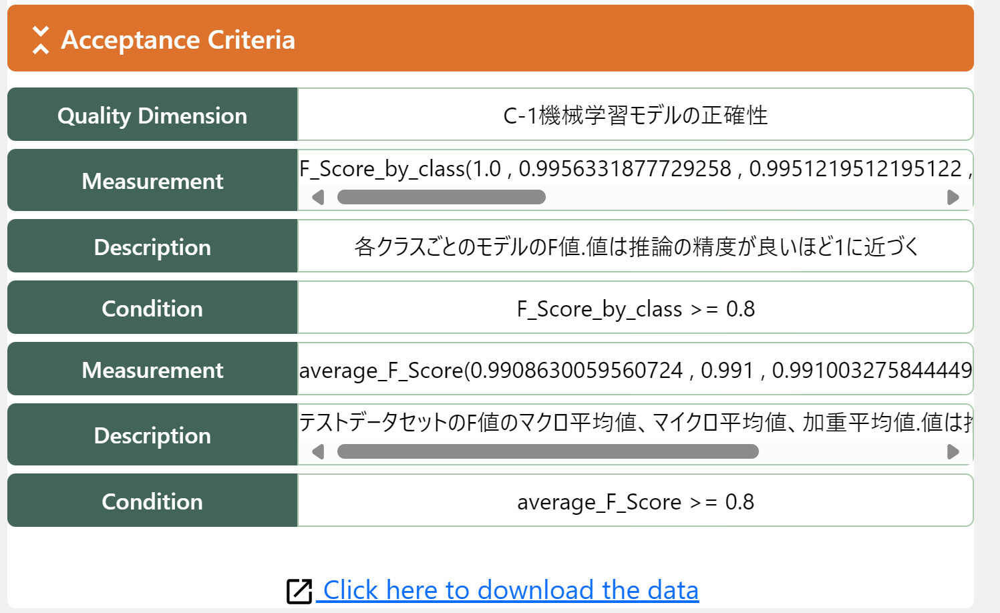

画面右が見解記入領域です。 上部は、AITが出力した画像のうちどれを最終的な結果ドキュメントに含めるかの設定ができます。 今回の結果に対して見解を記入し、Saveボタンを押下しましょう。

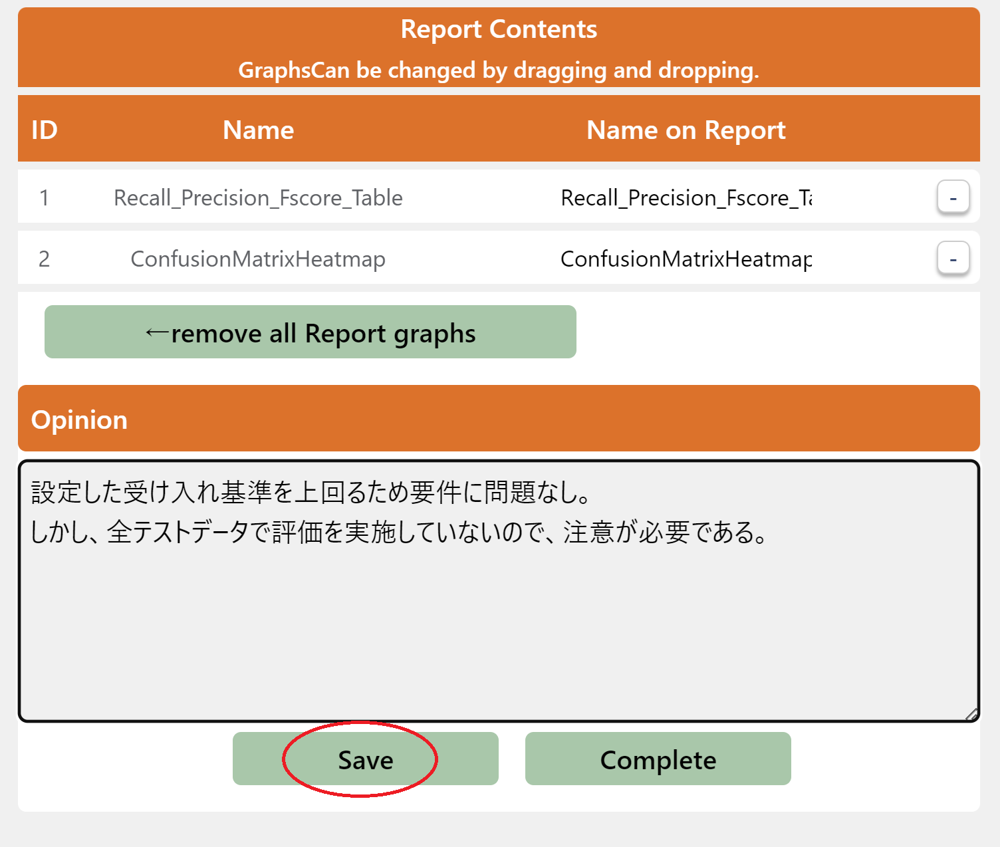


#### 4.6.3.データセットの意外性の評価結果の確認

データセットの意外性の評価結果も確認しておきましょう。本AITは、Distance-based Surprise Coverageの分布の表とその分布を基にした棒グラフ、Likelihood-based Surprise Coverageの分布の表とその分布を基にした棒グラフを出力します。    

Distance-based Surprise Coverageの分布の棒グラフを確認するとバケット11以降の割合が多くなっています。これは、テストデータの中に訓練データと異なる特徴を持つデータが多いことを示しています。

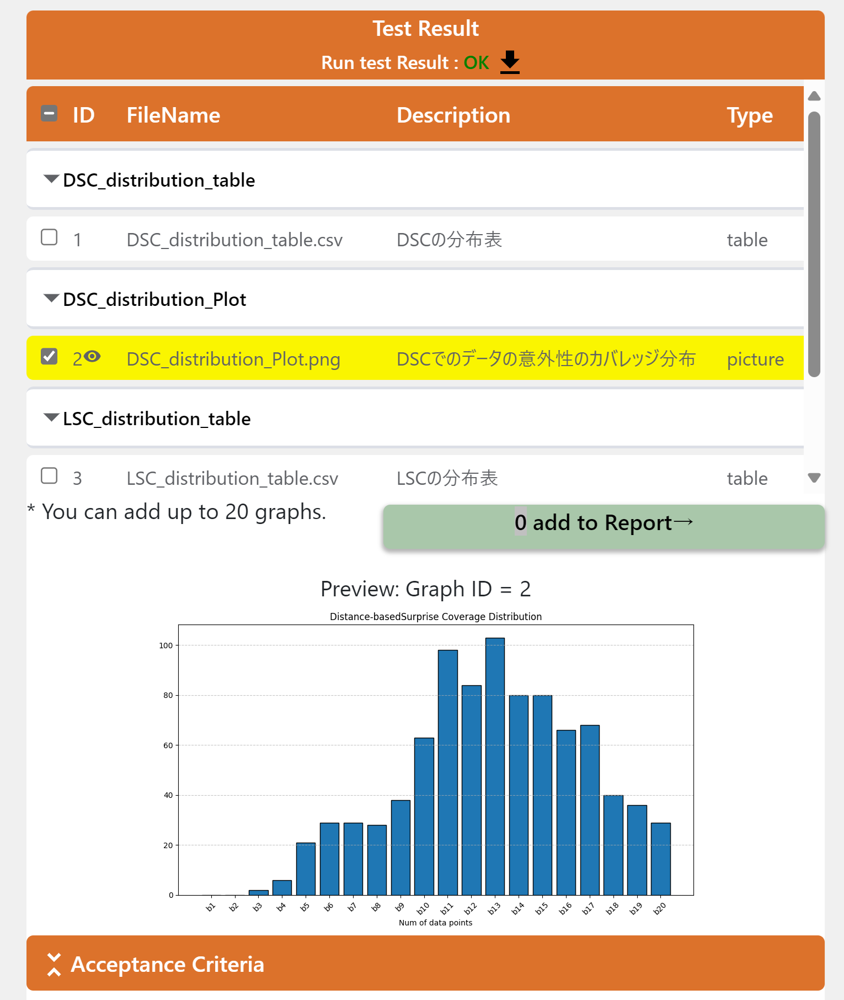

Likelihood-based Surprise Coverageの分布の棒グラフを確認するとバケット1の割合が多くなっています。これはモデルが訓練データに過剰に適応している可能性を示唆しています。

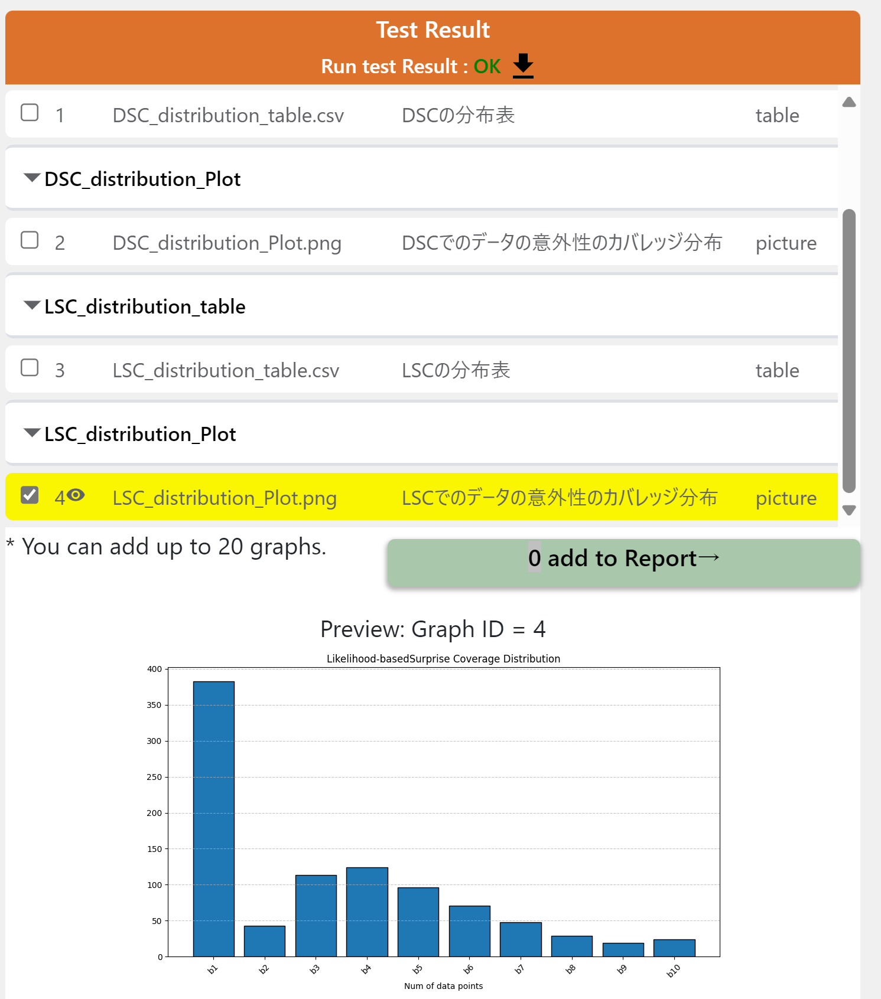

Distance-based Surprise CoverageとLikelihood-based Surprise Coverageの値を確認し、品質見解を記載します。

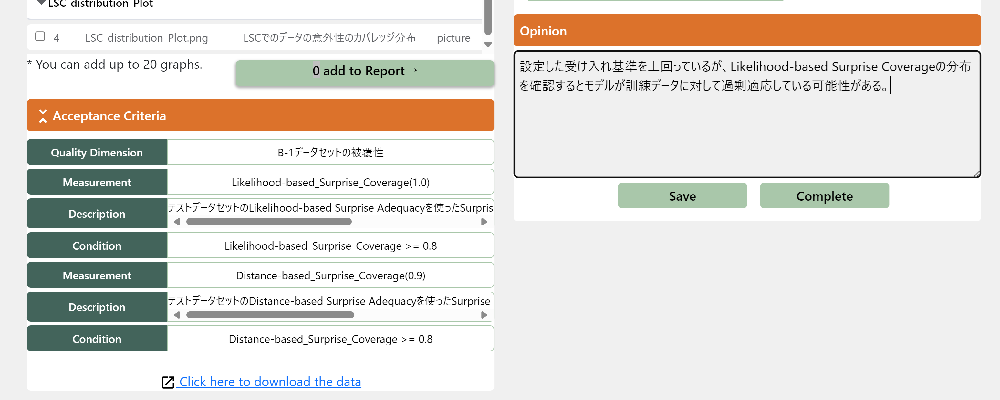

#### 4.6.4 データセットの分布の評価結果の確認

データセットの属性値分布の評価結果も確認しておきましょう。ステータスにNGが表示されています。これは設定した受け入れ基準を満たしていないクラスが1つ以上あることを示しています。テスト結果の測定値を確認してみます。train_Area_Topcoverage_AUCで受け入れ基準を満たしていないのが、      
クラス1：0.2944、クラス6：0.5967、クラス9：0.5861となっています。クラス6とクラス9は基準を上回っていませんが、基準と大きく離れていないのでよしとします。一方でクラス1に関しては基準と大きく離れています。実データを確認してみます。

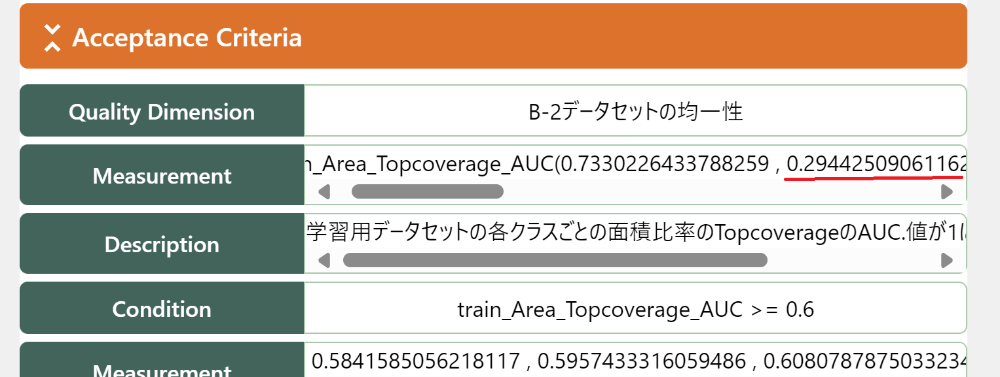

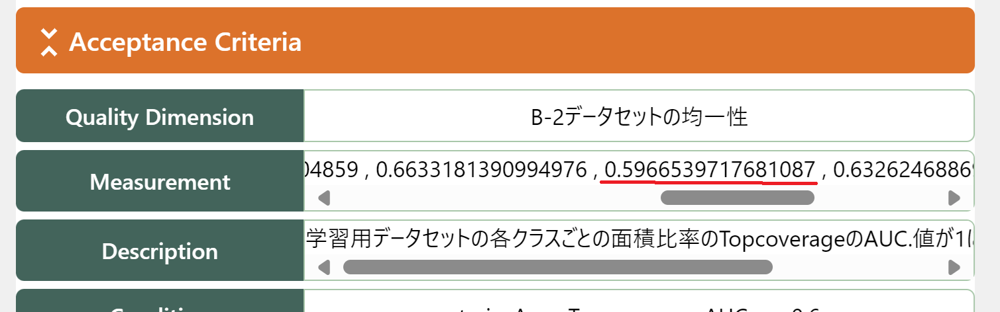

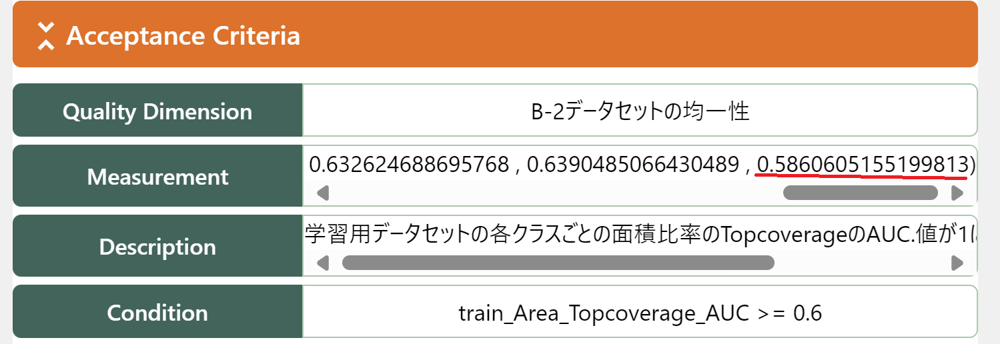

クラス1の面積比率が最小の画像と最大の画像と中央値の画像です。数字の1の書き方の特性で、AUCが小さくなっていることがわかります。    
同様の理由で、test_Area_Topcoverage_AUCでクラス1が基準を大きく下回っているのでしょう。

| 面積比率最小の画像 | 面積比率最大の画像 | 面積比率が中央値の画像　|
|------------------------|----------------------|----------------------|
| 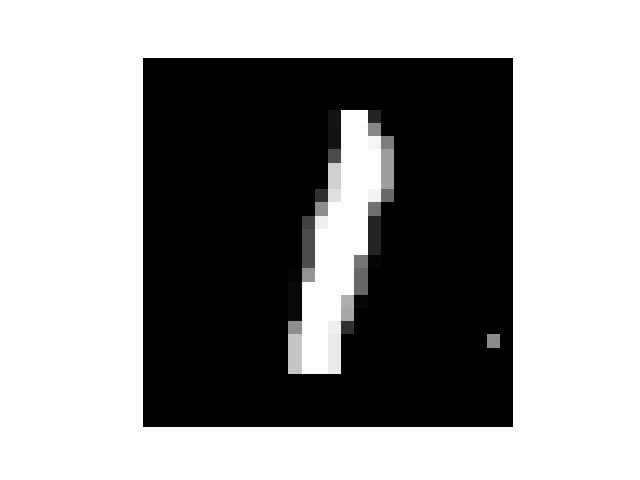 | 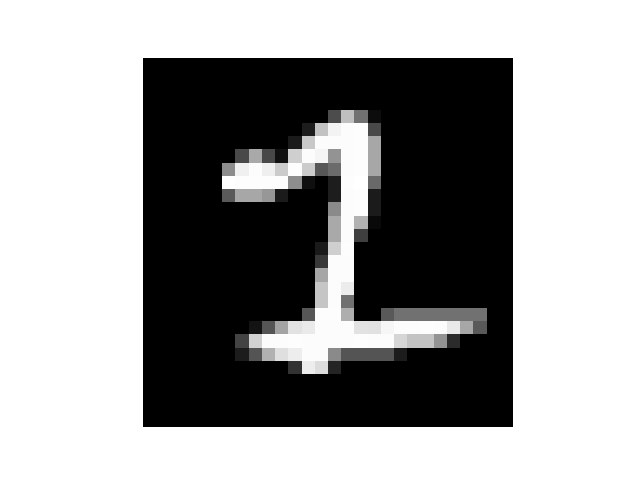 | 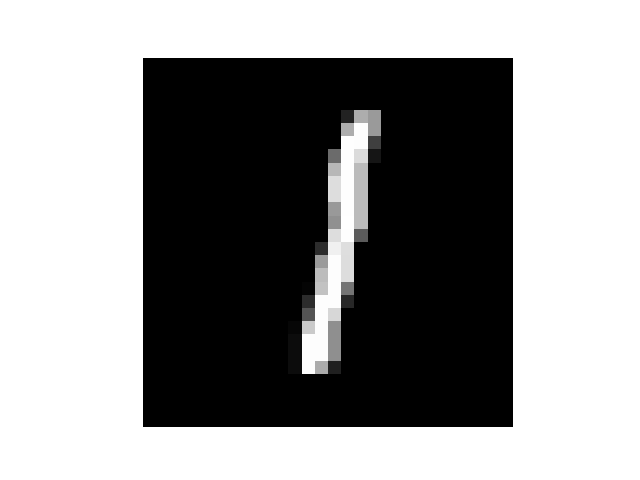 |

また、train_Brightness_Topcoverage_AUCがクラス1だけ基準を大きく下回っていることも実データから説明できます。    
画像の数字が傾いているため平均明度が小さくなってしまい、傾いていない数字の画像は平均明度が大きくなっています。数字が傾いているとバウンディングボックスが大きくなるため、平均明度が小さくなっていることがわかります。    
同様の理由で、test_Brightness_Topcoverage_AUCでクラス1が基準を大きく下回っているのでしょう。


| 平均明度最小の画像 | 平均明度最大の画像 | 平均明度が中央値の画像　|
|------------------------|----------------------|----------------------|
| 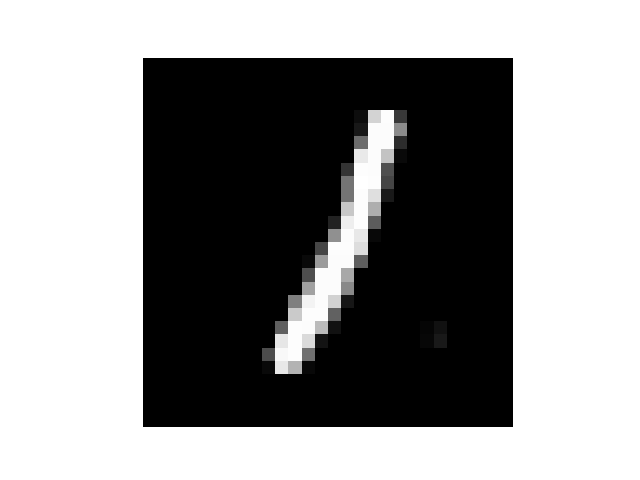 | 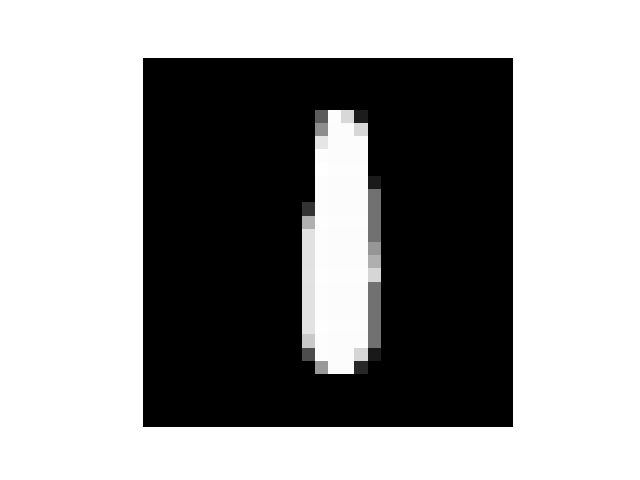 | 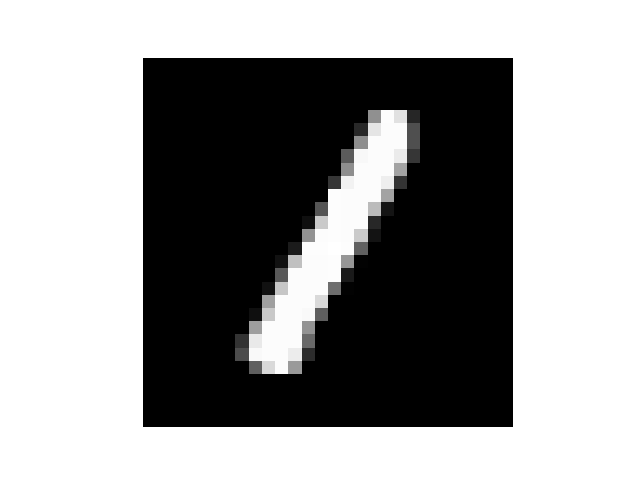 |


本AITは、1つのクラスにつき面積比率、平均明度、原点からの物体の中心座標の距離、3つのプロットが表示されます。今回は訓練データとテストデータはそれぞれ10クラスあるので、合計60枚の画像データが表示されます。
クラス1以外のプロットが問題ないことを確認します。

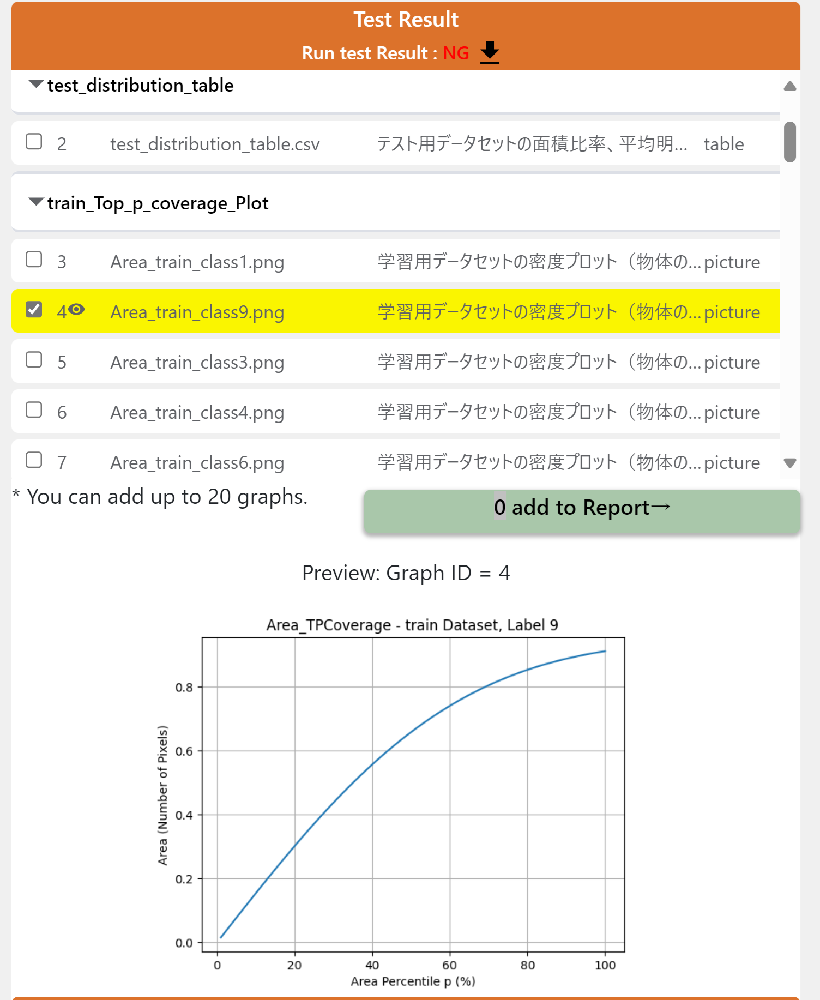

品質見解にクラス1について、記載をします。

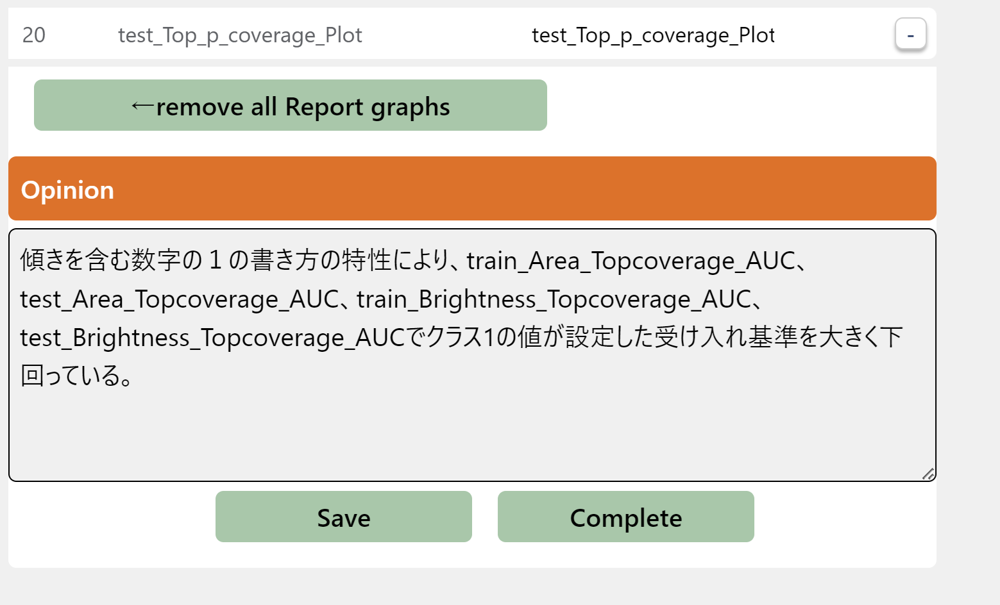

#### 4.6.5.モデルのロバスト性の評価結果の確認

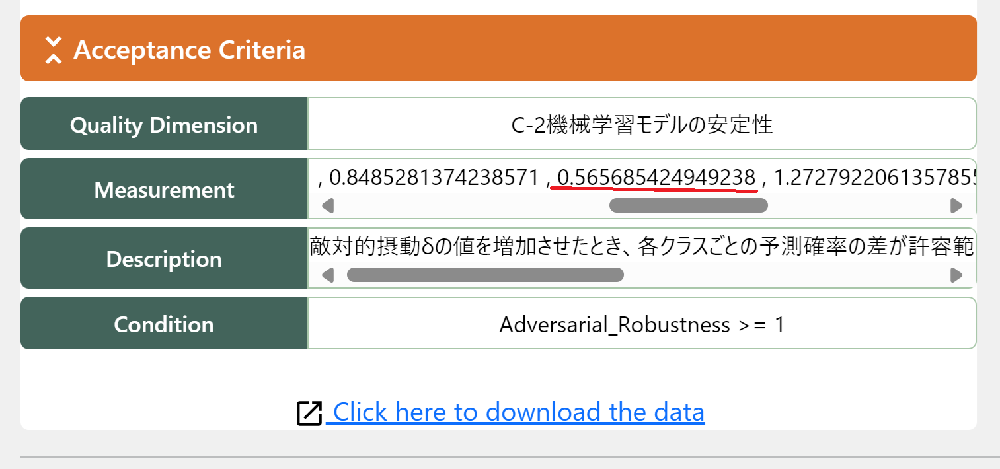モデルのロバスト性の評価結果も確認しておきましょう。ステータスにNGが表示されています。これは設定した受け入れ基準を満たしていないクラスが1つ以上あることを示しています。テスト結果の測定値を確認してみます。受け入れ基準を満たしていないのが、    
クラス2：0.9899、クラス3：0.8485、クラス4：0.8485、クラス5：0.5657、クラス9：0.4243となっています。クラス5とクラス9の画像に対して敵対的摂動を加えた敵対的データに対してモデルが著しく弱いことがわかりました。今回のモデルは敵対的訓練を行っていないので、その影響が出たのでしょう。    

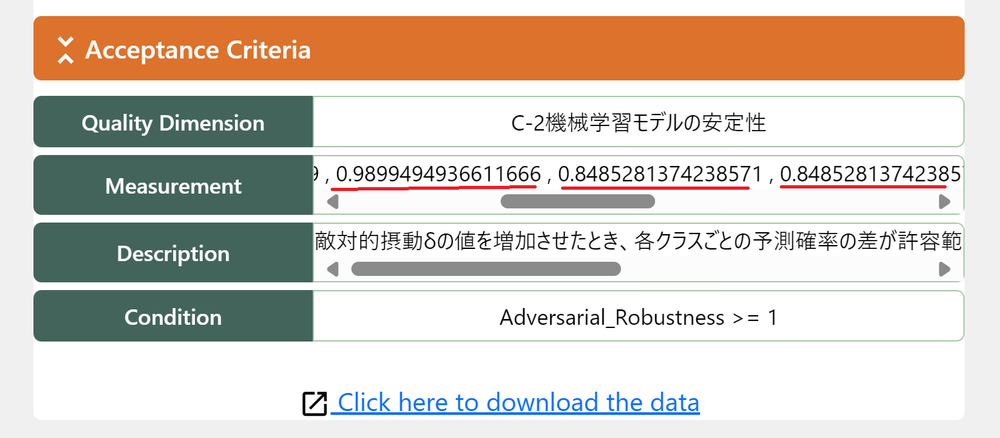

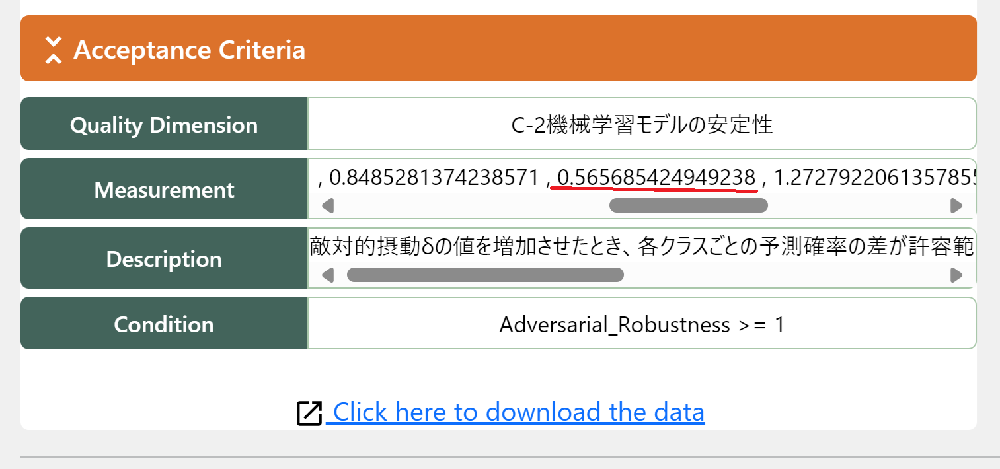

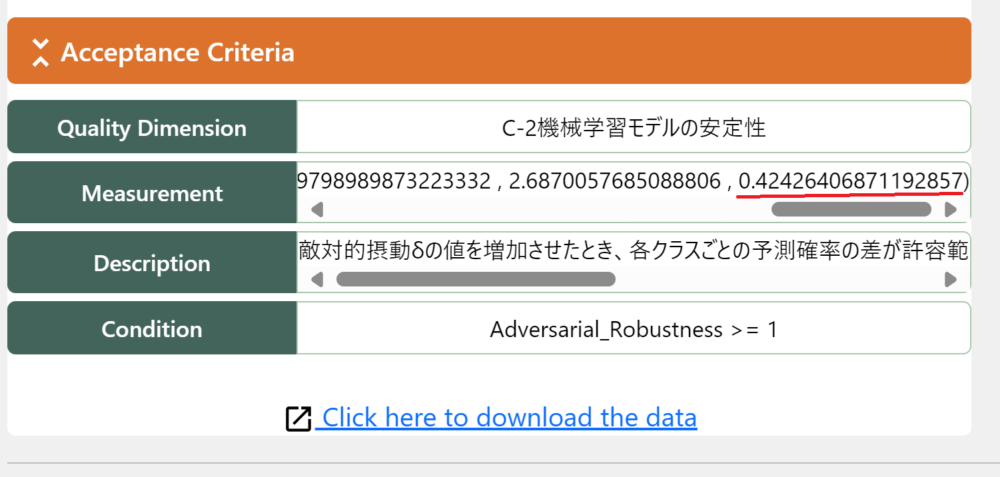


また、本AITは1クラス1枚の画像データが表示されるので、今回は10枚分の画像データが表示されます。クラス5とクラス9のプロットを確認します。クラス5に対して敵対的摂動が0.5の時に違反している（許容範囲外になっている）ことがわかります。

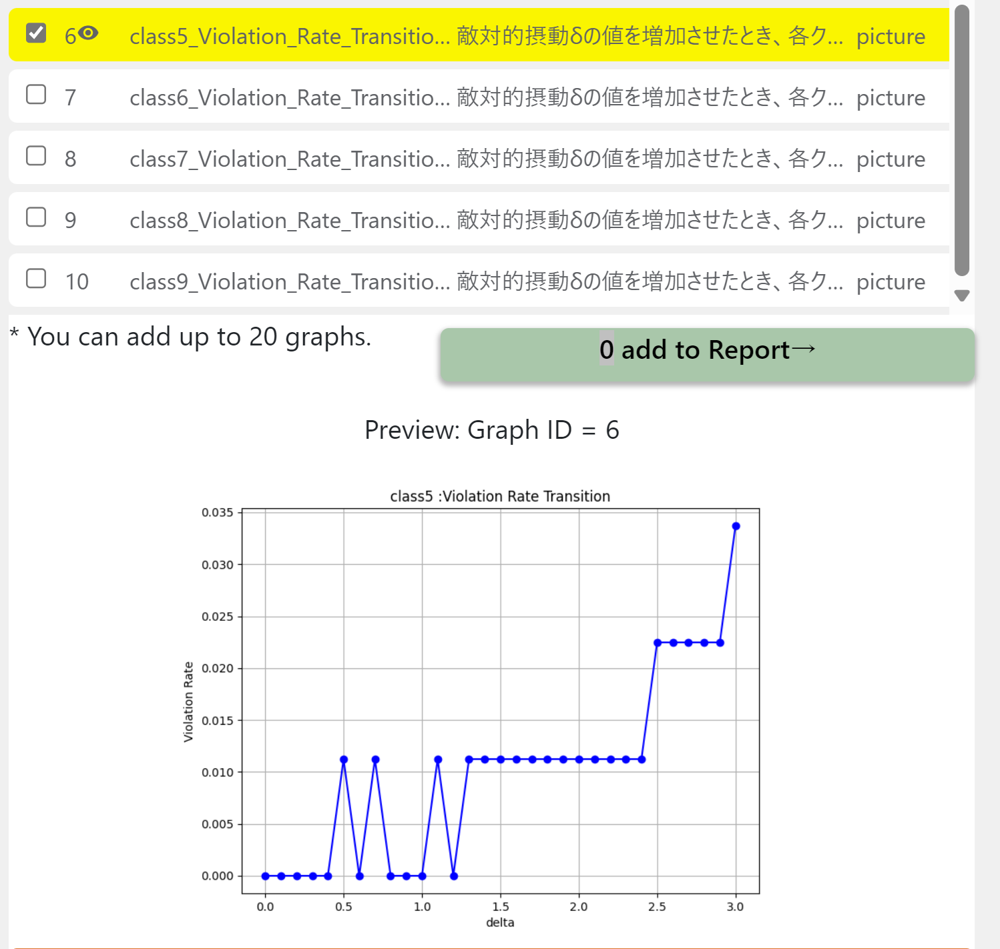

また、クラス9に対して敵対的摂動が0.4のときに違反していることがわかります。

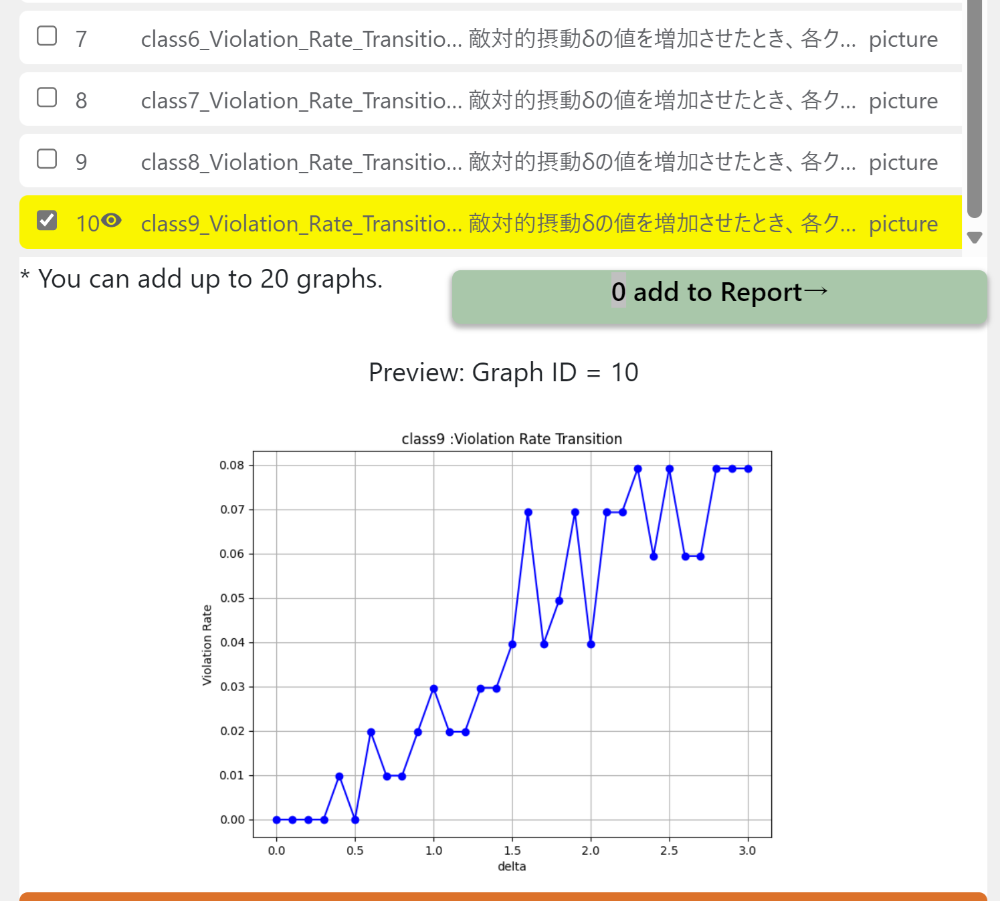

品質見解にモデルの訓練時に敵対的訓練を取り込む必要があることを記載します。

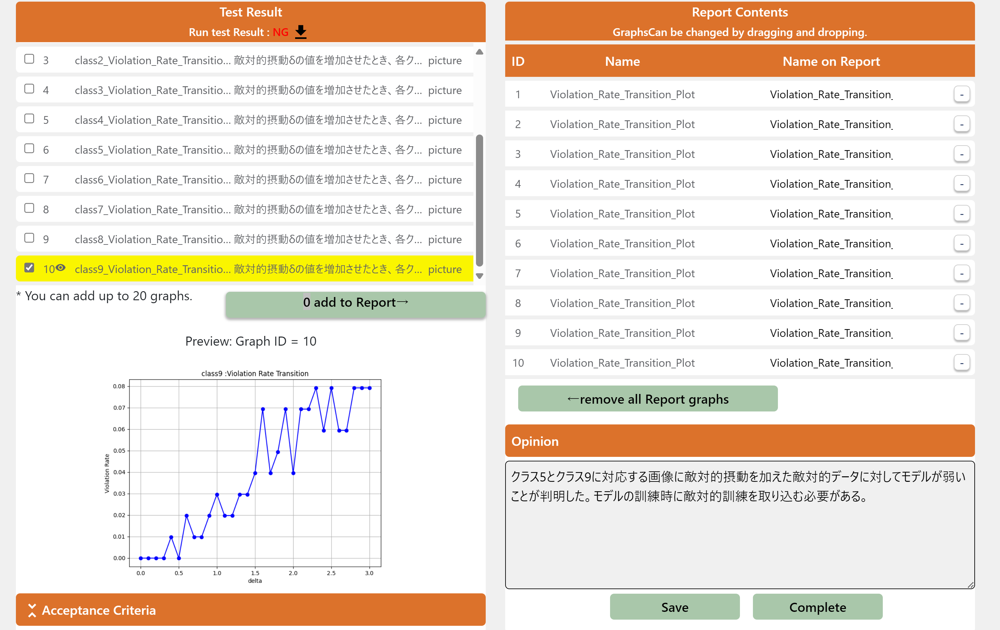

## 5.品質評価を踏まえたモデルの評価
4.6.5.節でモデルが敵対的データに対して弱いことが判明したので、敵対的訓練を訓練時に取り込んだモデルを準備して、もう一度モデルの精度とロバスト性の評価を行います。    
モデルに関しては7章で説明・配布します。

### 5.1モデルの精度
#### 5.1.1テスト仕様(Test Description)の登録とモデルの登録
4.5.2節で登録したモデルの精度のテスト仕様と同様の設定が多いためこちらをコピーして今回のテスト仕様を登録します。    
Edit Optionの一番左のアイコンを押下します。

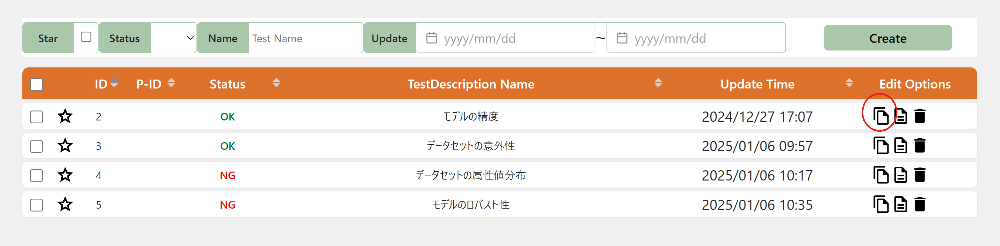

名前を以前のものと違いが分かるように今回は設定します。

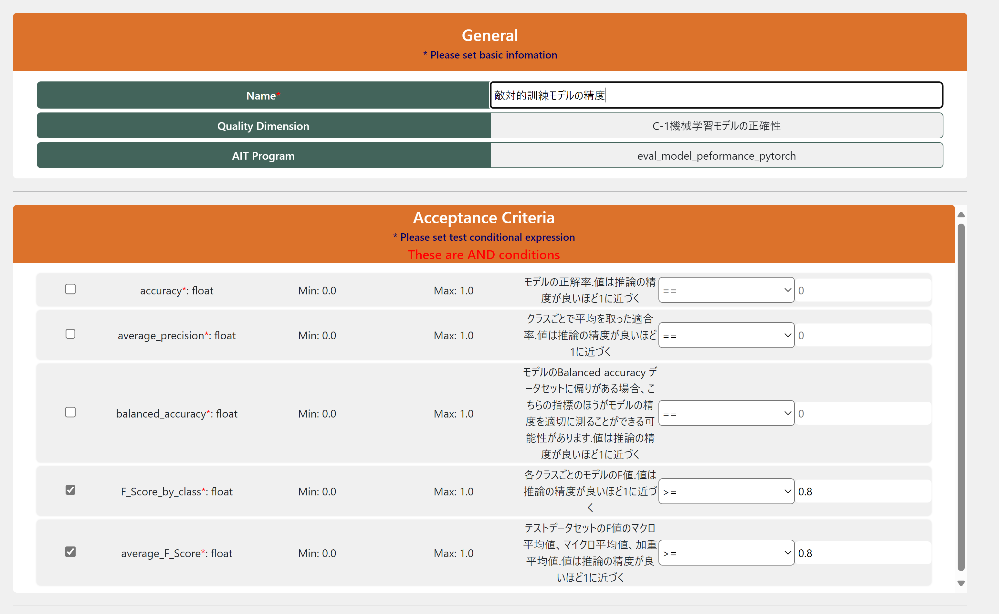

敵対的訓練を訓練時に取り込んだモデルをこの画面から登録することも可能です。    
Target Inventoriesのtrained_modelの欄の一番右のプラスのアイコンを押下します。

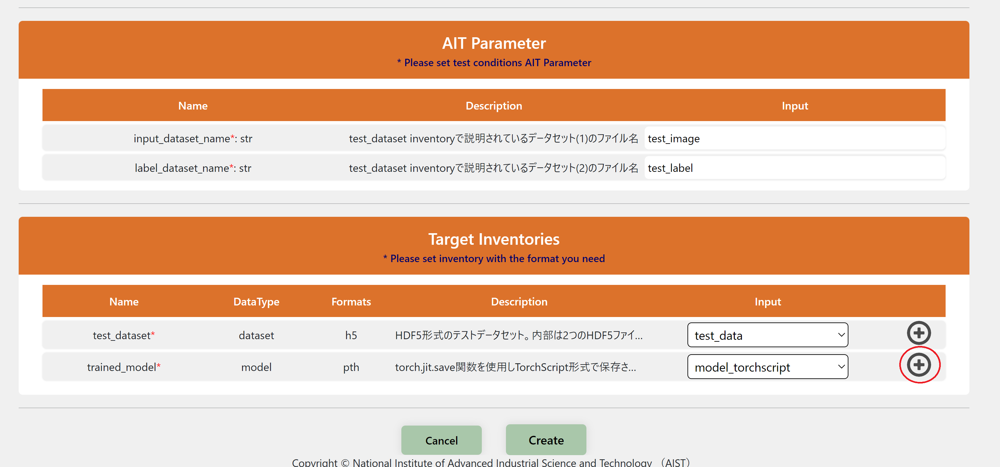

4.5.1節でモデルを登録する際に表示された画面が表示されます。torchscript形式に変換されたモデル (こちらからダウンロード) をPC上に配置し、Path欄にはそのファイルパスを入力してください。

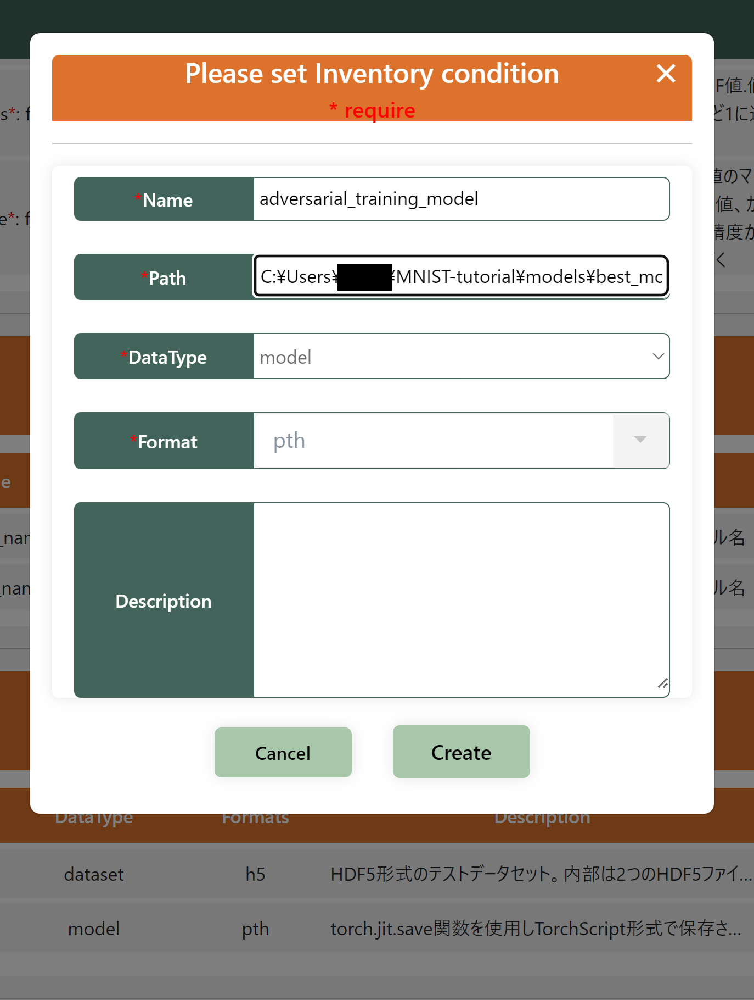

先ほど登録したモデルを選択し、Createを押下します。

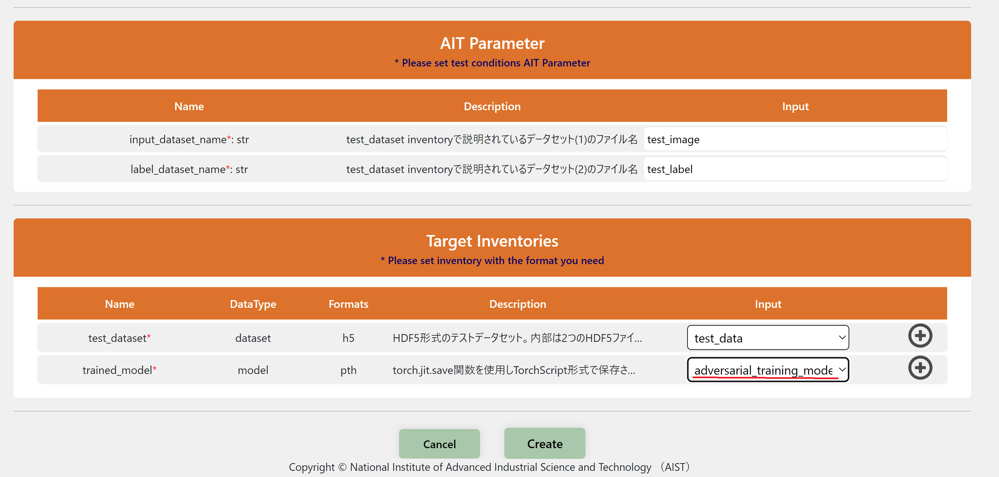





#### 5.1.2実行と評価確認

MLコンポ―ネントのテスト仕様画面に遷移し、先ほど設定したテスト仕様にチェックを入れて、`Run Test`を押下してください。

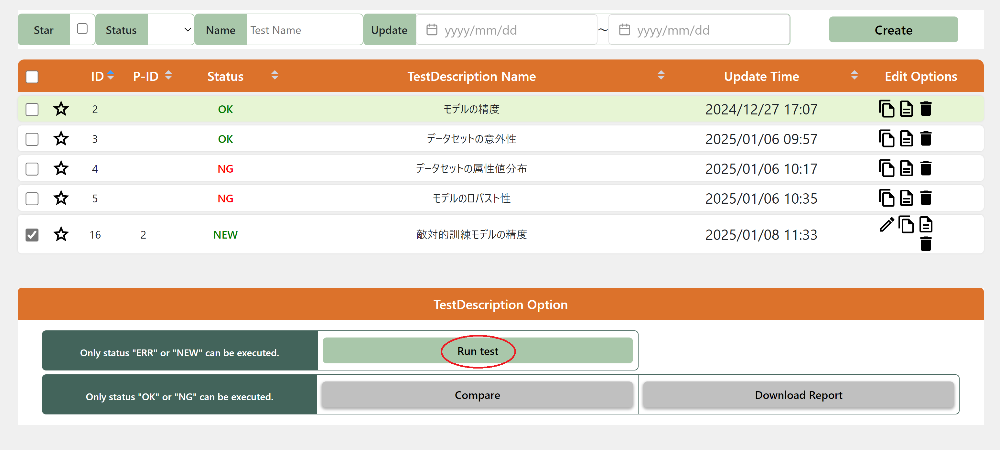

実行完了後、実行結果のステータスがOKになっていることを確認し、詳細を押下します。

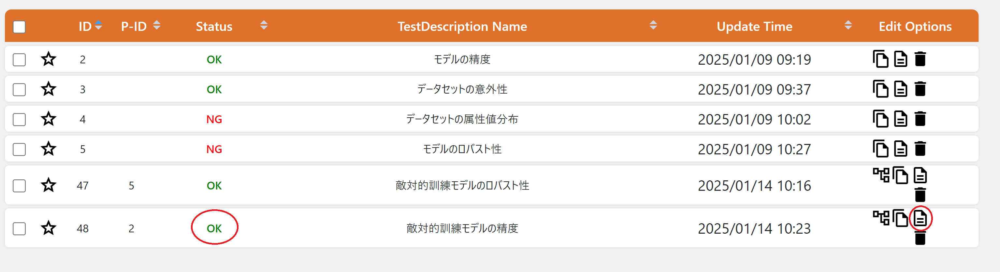

各クラス誤とのF値とF値のマイクロ平均値、マクロ平均値、加重平均値が受け入れ基準を上回っていることを確認します。
F値は4.6.2節に比べて小さくなっており、差が大きいところで約0.03となっています。しかし、あまり問題はないでしょう。

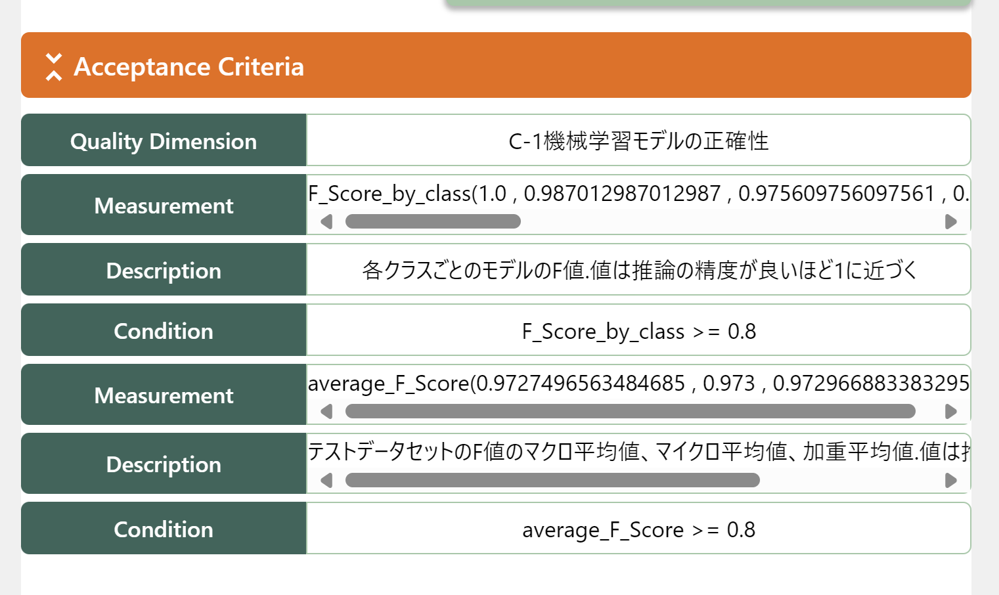


## 5.2モデルのロバスト性
#### 5.1.1テスト仕様(Test Description)の登録とモデルの登録
5.1節と同様にモデルのロバスト性を、以前登録したモデルのロバスト性をコピーして今回のテスト仕様を登録します。

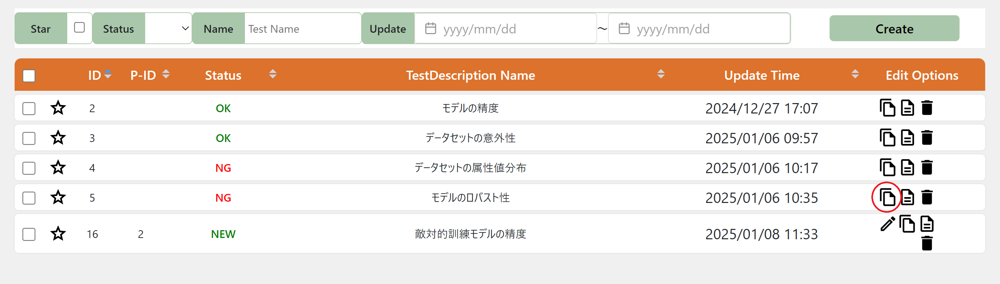

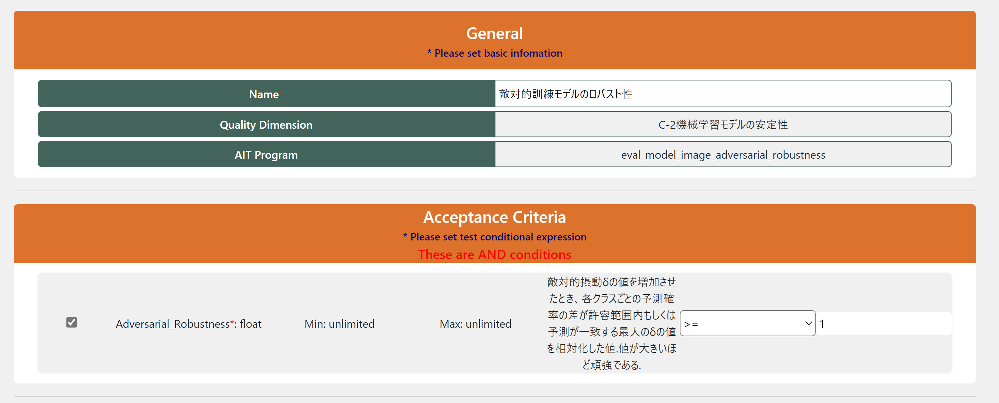

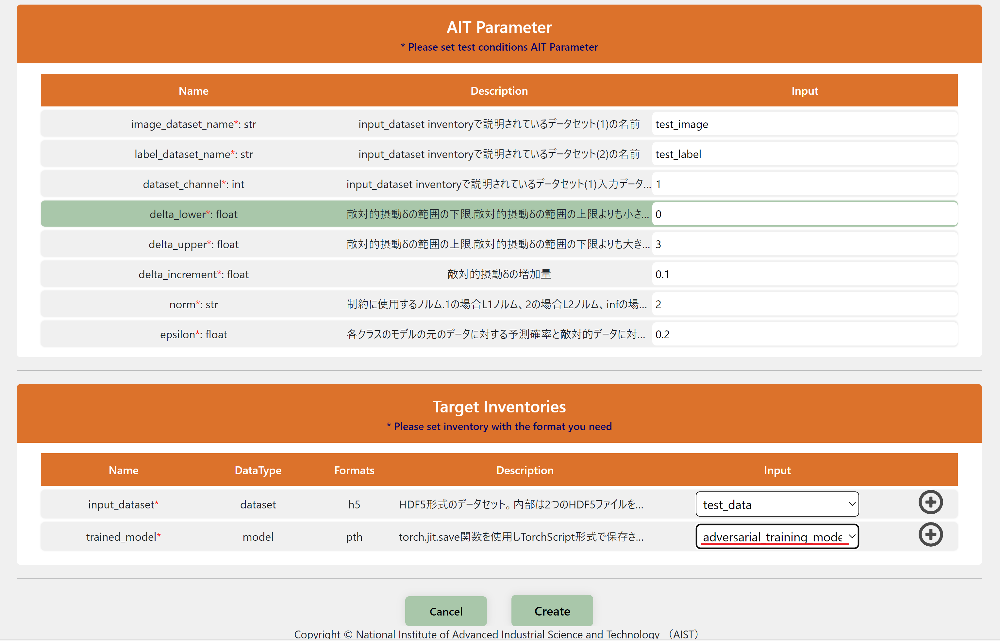


#### 5.2.2実行と評価確認

MLコンポ―ネントのテスト仕様画面に遷移し、先ほど設定したテスト仕様にチェックを入れて、`Run Test`を押下してください。    
実行完了後、実行結果が4.6.5節と異なり、ステータスがOKになっていることを確認し、詳細を押下します。

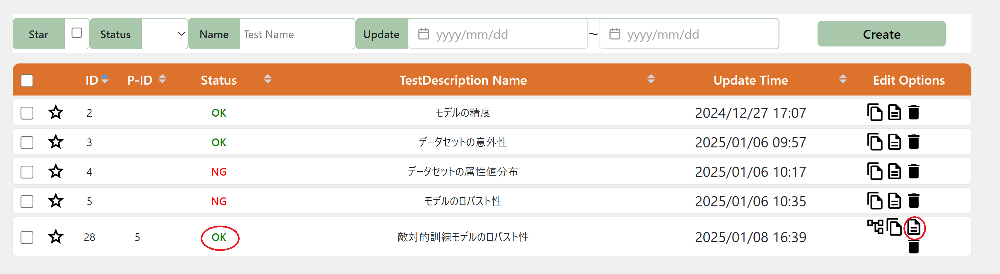

測定値を確認すると、    
クラス2：2.121、クラス3：1.273、クラス4：1.273、クラス5：1.273、クラス9：1.131となっており4.6.5節のときに比べて改善されていることがわかります。

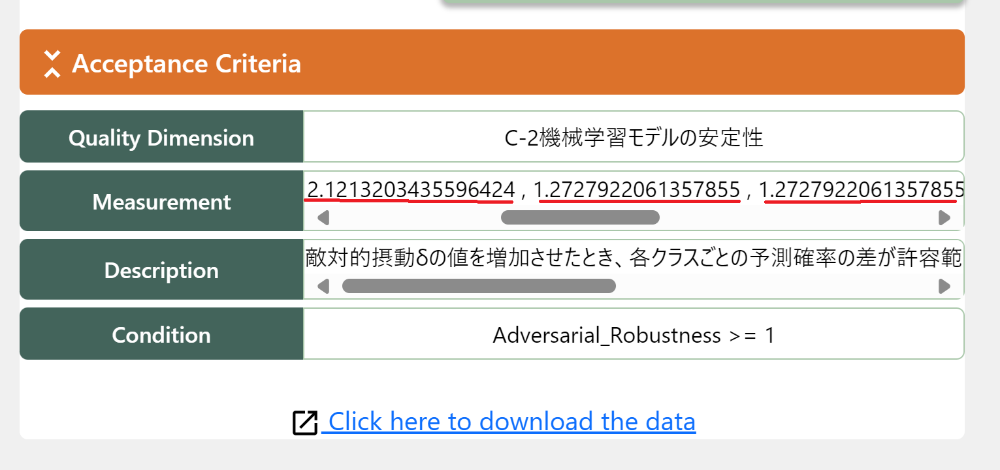

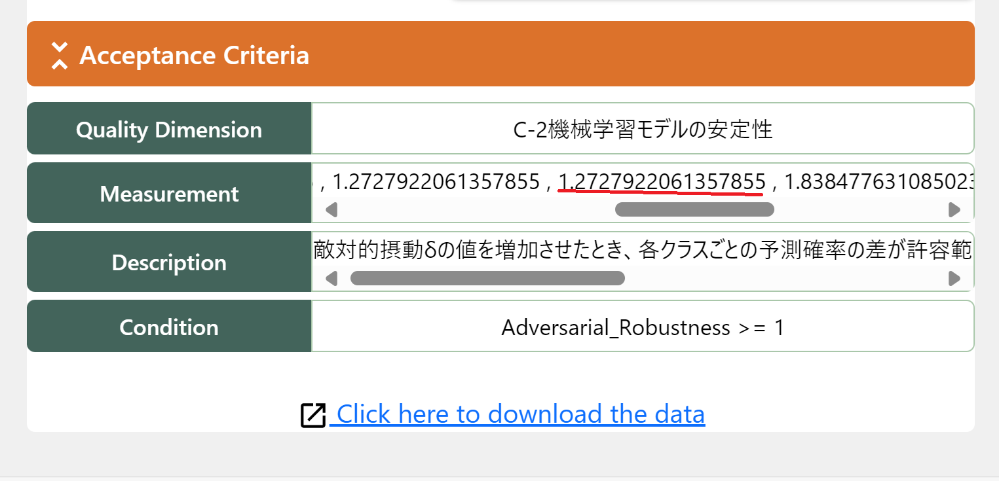

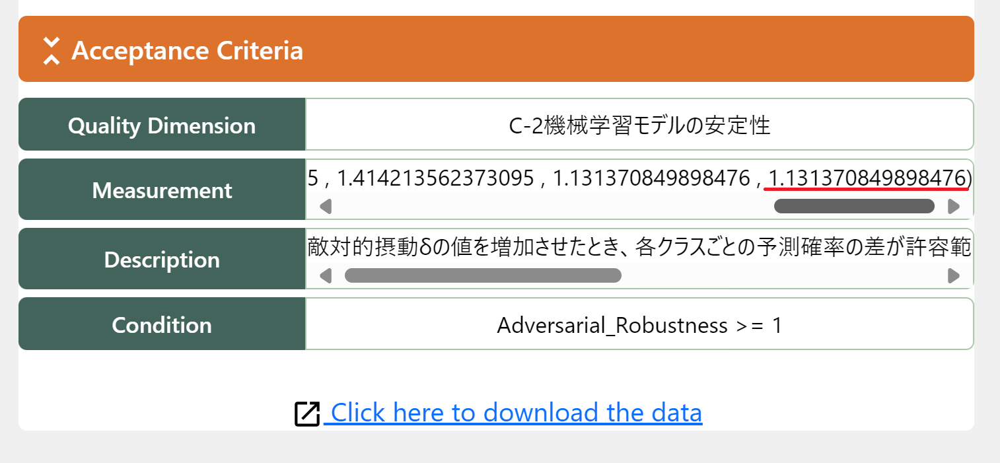



### 5.3.品質レポートの作成

テストが実行できましたので、実行したすべてのテストの結果をまとめた品質レポートを作成します。 前の画面に戻り、Download Reportボタンを押下してください。

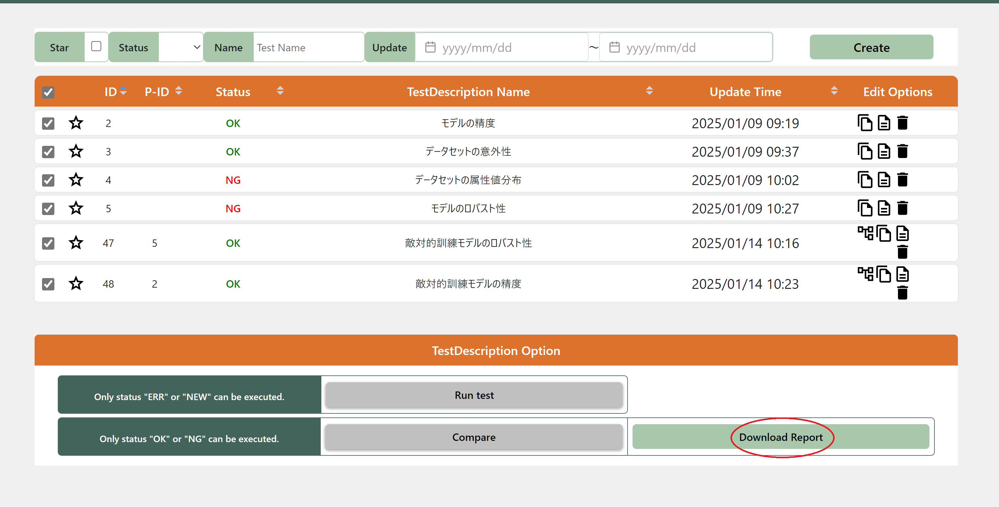

レポート生成時に、ガイドライン・標準にあわせて体系的に結果出力を行いますので、テンプレートを選んでください。 ここでは産総研AI品質マネジメントガイドライン（AIQMガイドライン）のテンプレートを選びます。

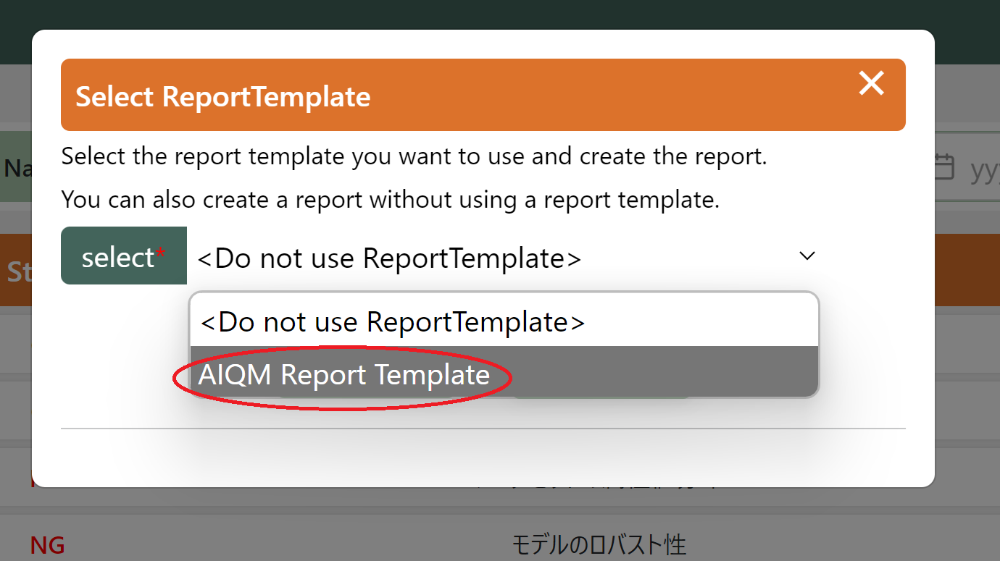

プレビューから生成予定のレポートを閲覧できます。 ページを送っていくと、2.8節、2.9節、2.11節、2.12節にてそれぞれB-1、B-2、 C-1、C-2の評価結果が出力されています。 受け入れ基準を通過したことを表す pass もしくは受け入れ基準を通過したことを表す failure が表示され、入力した見解も表示されています。 これにより、後からどの品質特性に対してどのような評価が行われ、どのような判断があったかを追跡することができます。

| 節 | 判定結果 | 補助資料 |
|-------------------------|-------------------------|-------------------------|
| 2.8 | 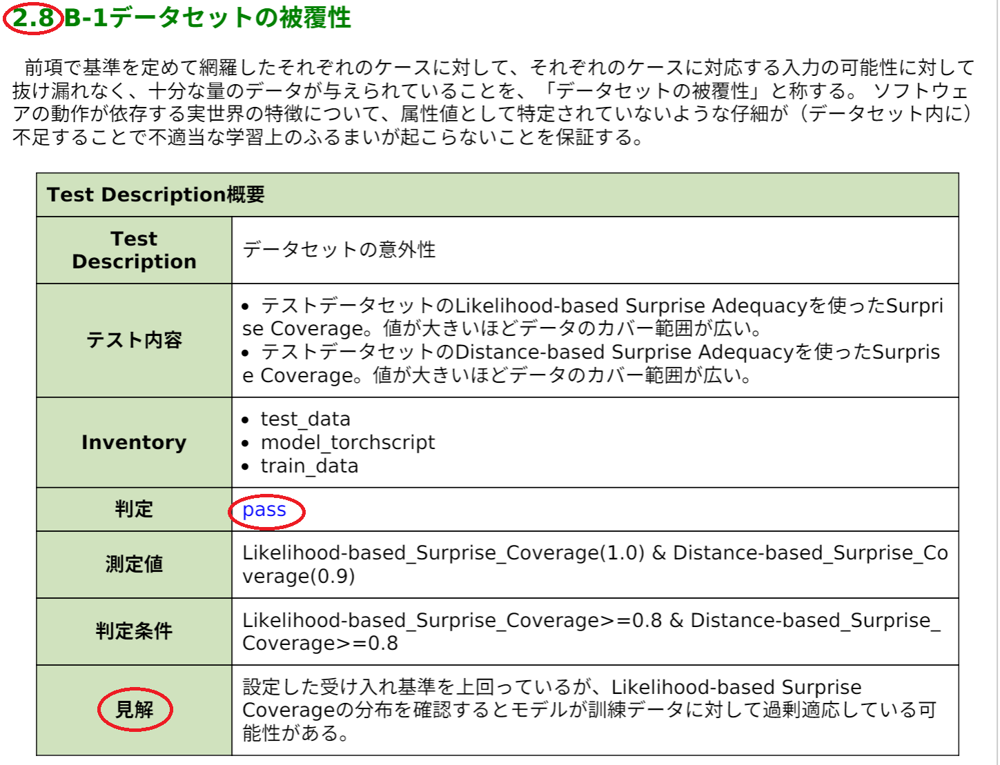 | 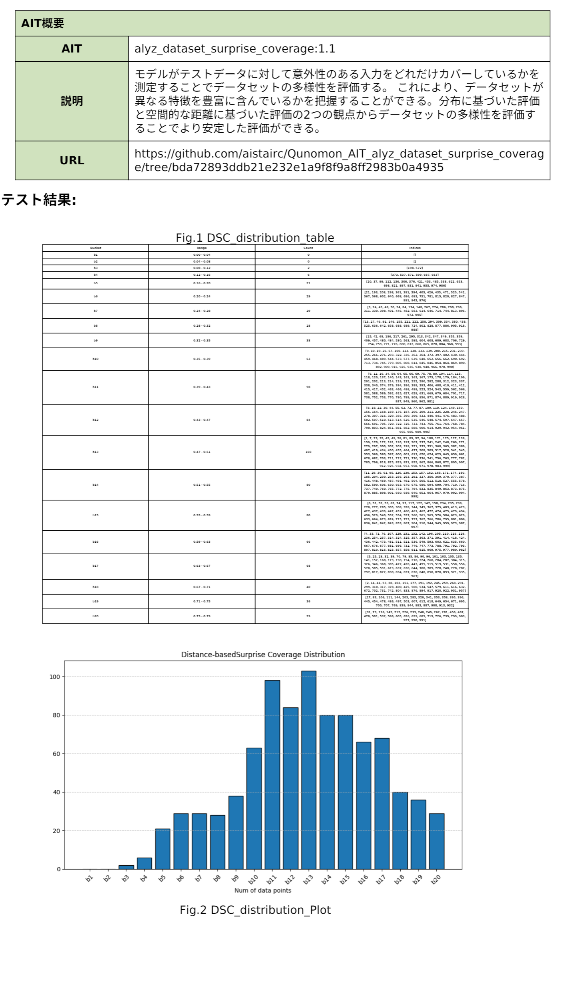 |
| 2.9 | 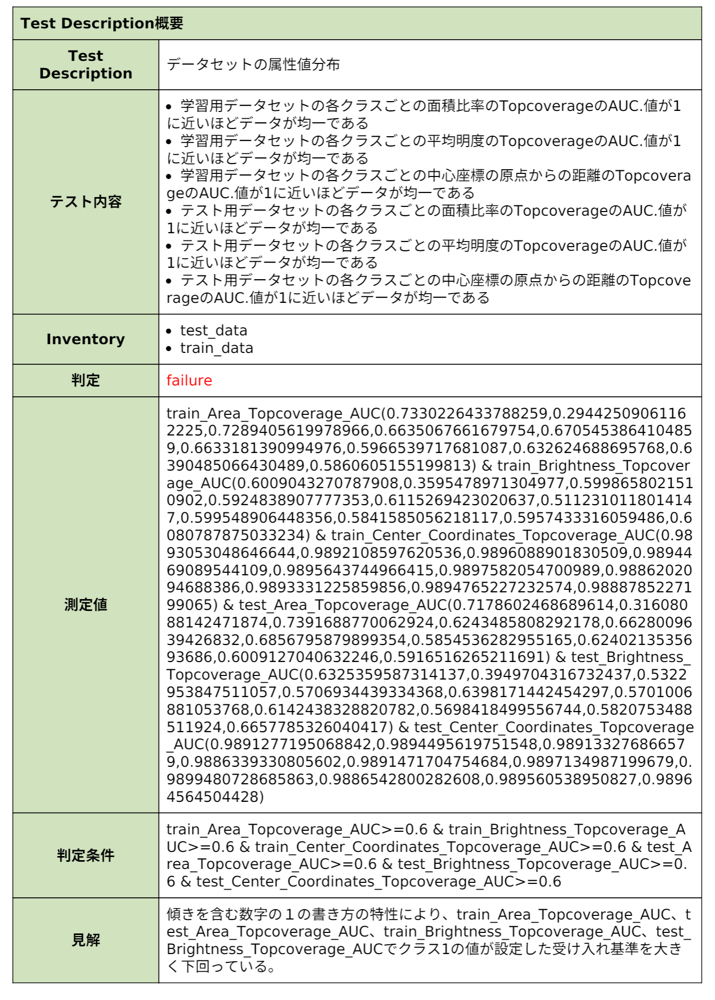 | 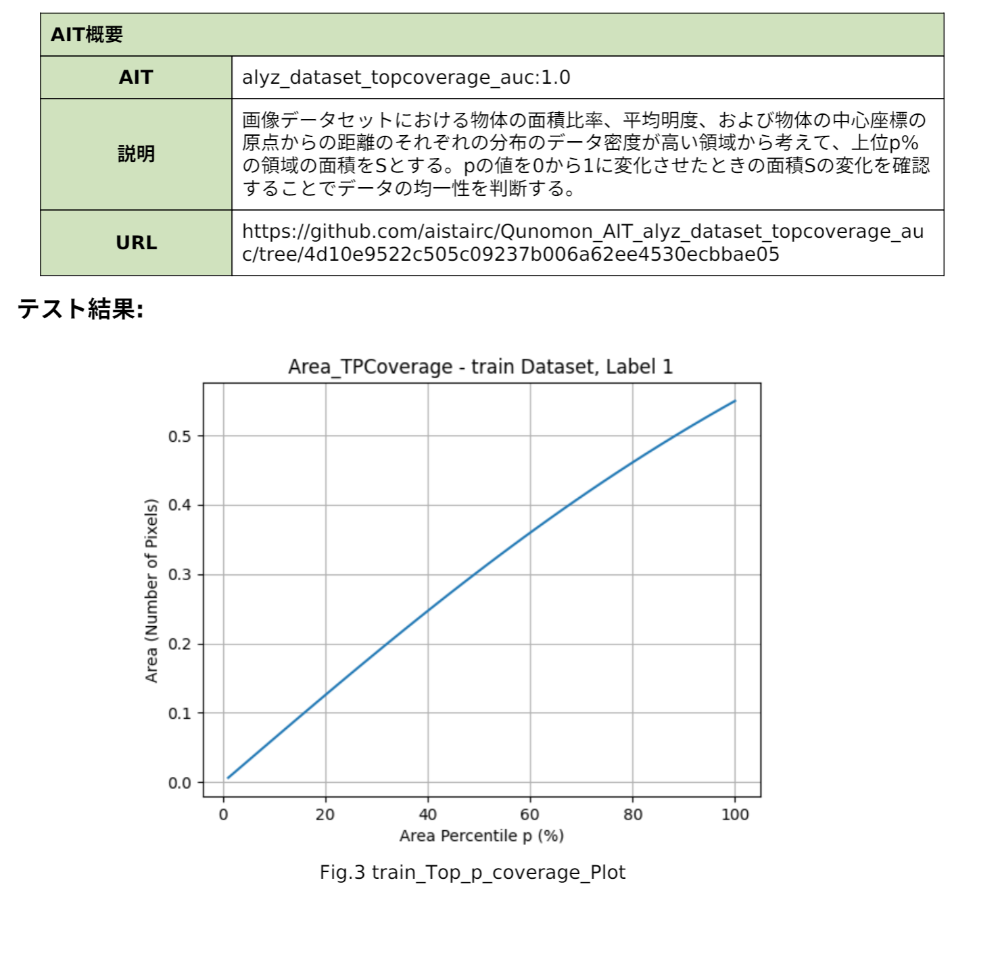 |
| 2.11 | 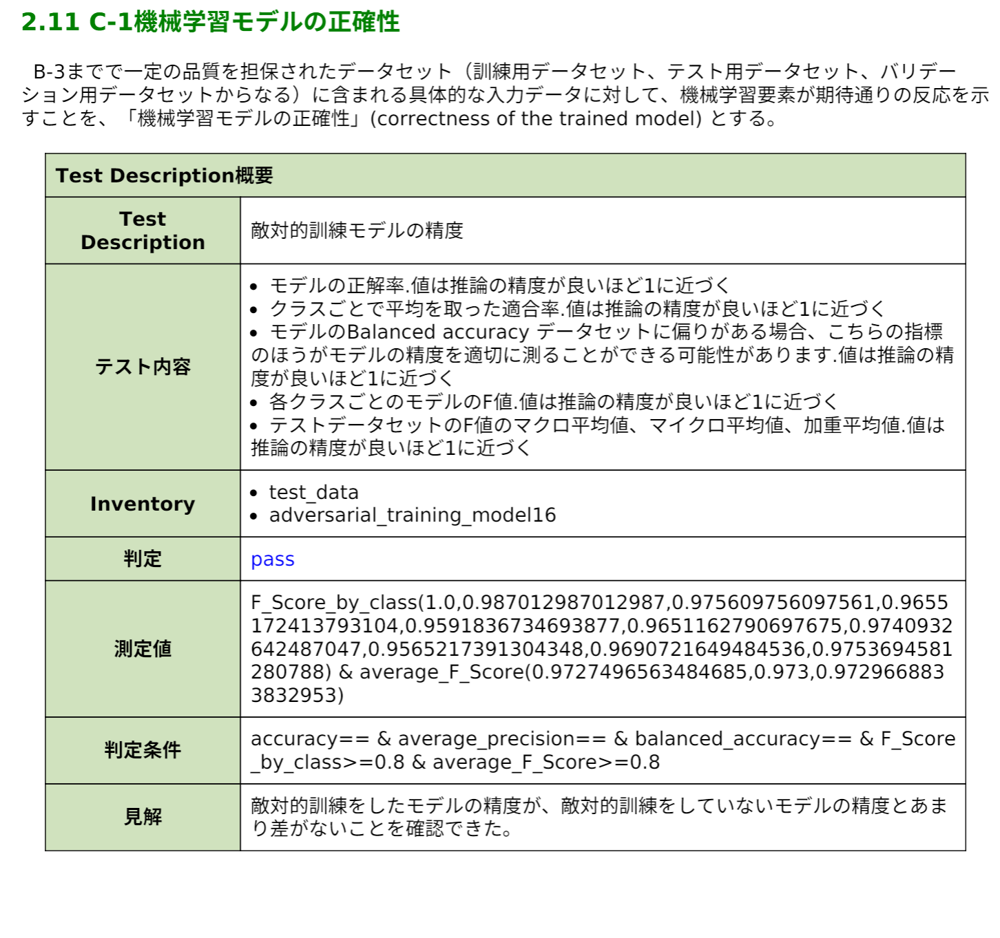 | 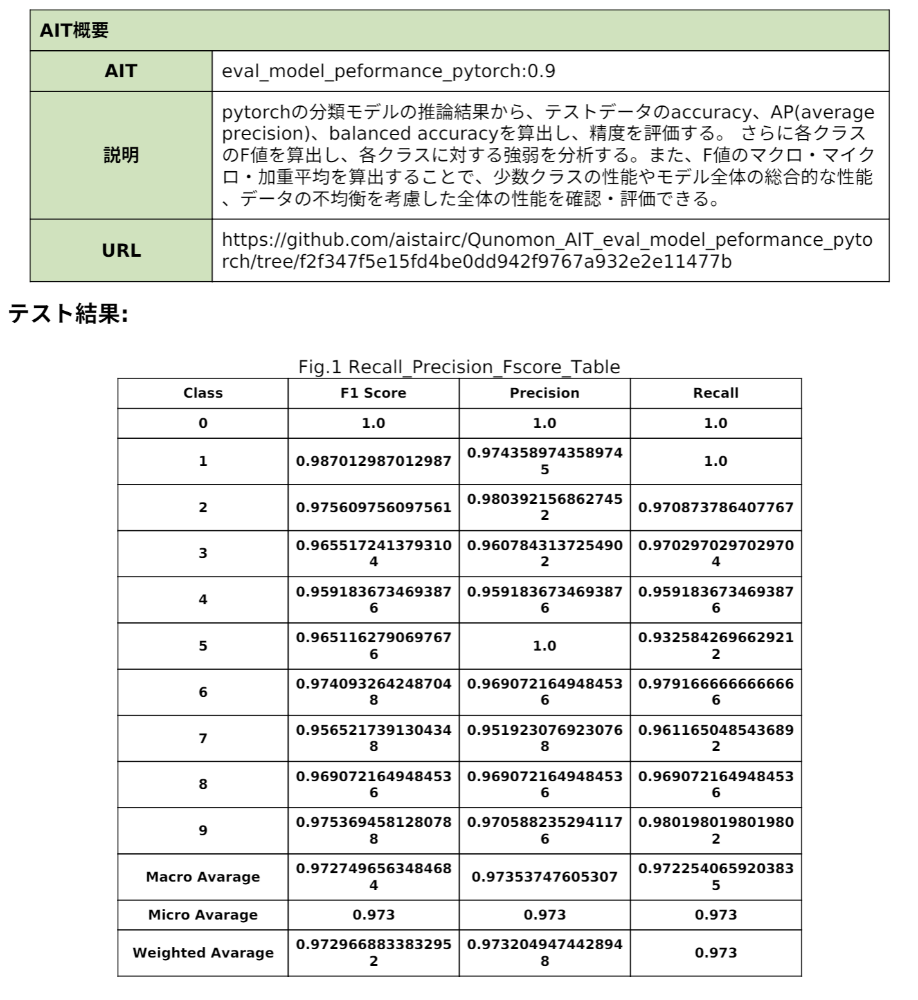 |
| 2.12 | 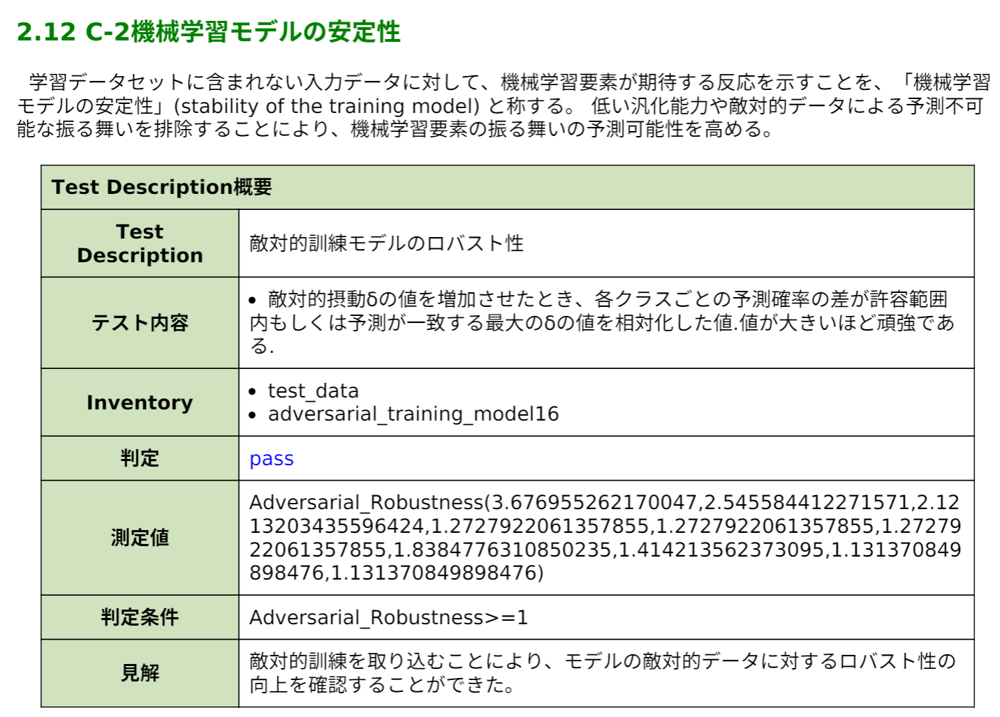 | 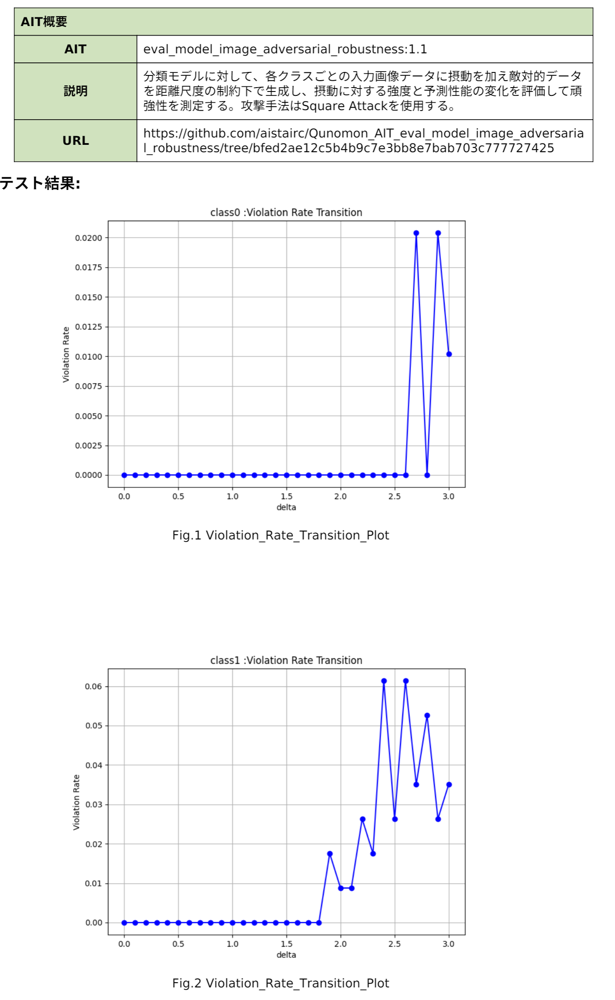 |

最後に画面左側よりレポートを生成しましょう。PDF形式でダウンロードされ、後から参照できるようになります。

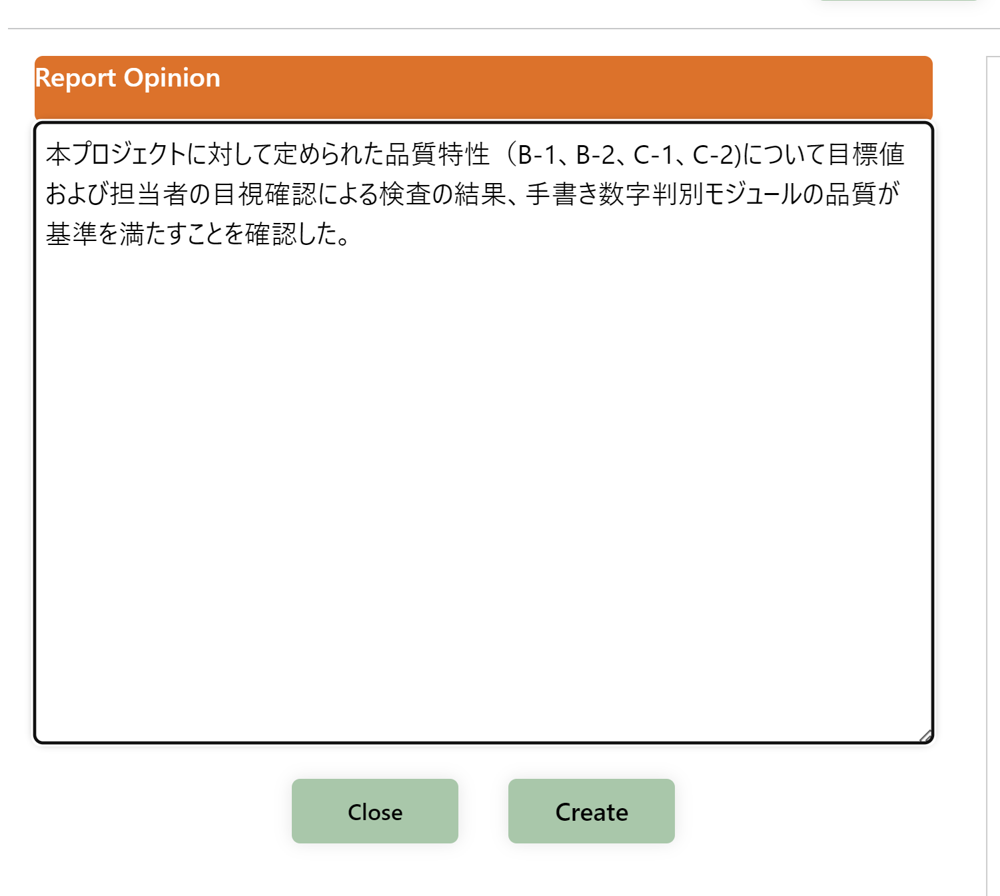

----------------------------------------------------------------------------------------
# 第二部 機械学習コンポーネントの準備方法

## 6. 推論モデルの準備
本チュートリアルで配布しているモデルの構築・訓練の手順を記載します。
### 6.1 モデルの構築
簡単かつ高速に画像分類モデルの構築をするため、ここではLeNet-5の構造を参考に、活性化関数を正規化線形関数、プーリング層をMaxPooling、ドロップアウト層を設定して、モデルを構築します。

In [3]:
import torch.nn as nn
import torch.nn.functional as F
class LeNet5(nn.Module):
    def __init__(self):
        super(LeNet5, self).__init__()
        self.conv1=nn.Conv2d(1, 16, kernel_size=5)
        self.pool1=nn.MaxPool2d(2)
        self.conv2=nn.Conv2d(16, 32, kernel_size=5)
        self.pool2=nn.MaxPool2d(2)
        self.conv3=nn.Conv2d(32, 64, kernel_size=4)
        self.dropout1 = nn.Dropout(p=0.25)
        self.fc1 = nn.Linear(64, 84)
        self.dropout2 = nn.Dropout(p=0.25)
        self.fc2 = nn.Linear(84, 10)


    def forward(self,x):
        x = F.relu(self.conv1(x))
        x = self.pool1(x)
        x = F.relu(self.conv2(x))
        x = self.pool2(x)
        x = F.relu(self.conv3(x))
        x = self.dropout1(x)
        x = x.view(-1,64)
        x = F.relu(self.fc1(x))
        x = self.dropout2(x)
        x = self.fc2(x)
        return x

### 6.2 データセットの読み込み

まずはデータセット準備で作成したMNIST/aug_train.h5を読み込みます。
訓練データの一部を検証用のデータとして使うため、訓練データを分割します。
その後、データローダを作成します。

In [4]:
import torch
from torch.utils.data import DataLoader ,random_split,TensorDataset
import h5py
def load_h5_data(h5_filename,x_name,y_name):
    """
    h5形式のデータセットからデータセットを作成する
    parameter:
        h5_filename:ファイルのパス
        x_name:ファイル内にある画像データセットの名前
        y_name:ファイル内にある正解ラベルデータセットの名前
        batch_size:バッチサイズ
    return:
        dataset:データセット
    """
    with h5py.File(h5_filename,'r') as h5_file:
        images = h5_file[x_name][:]
        labels = h5_file[y_name][:]
    images = torch.tensor(images,dtype=torch.float32)
    labels = torch.tensor(labels,dtype=torch.long)
    dataset = TensorDataset(images,labels)
    return dataset

#学習時に使用する訓練データのパスの設定
train_path="../resources/MNIST/aug_train.h5"

#訓練データセットの作成
train_dataset = load_h5_data(train_path,"train_image","train_label")

#訓練データの一部を検証用データにする
train_size = int(len(train_dataset)*0.8)
val_size = len(train_dataset)-train_size
train_data, val_data =random_split(train_dataset,[train_size,val_size])

#データローダの作成
train_loader = DataLoader(train_data,batch_size=64, shuffle=True)
val_loader = DataLoader(val_data,batch_size=64, shuffle=False)




### 6.3モデルの訓練

ここからはモデルの訓練をしていきます。学習時に検証用データで正解率と損失を計算し、バリデーションロスが一番小さいモデルを保存します。    
訓練設定は一般的な値を使ってます。    
本シナリオでの説明に最低限必要な調整のみになっているため、必ずしも最適とは限らないことにご留意ください。

In [5]:
model = LeNet5()

import torch.optim as optim
#損失関数と最適化手法の設定
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr = 0.001)

import os
#エポック数の設定とバリデーションロスの設定
num_epochs = 50
best_val_loss = float('inf')

for epoch in range(num_epochs):
    model.train()
    running_loss=0.0
    total = 0
    correct = 0
    for images, labels in train_loader:
        outputs = model(images)
        loss = criterion(outputs,labels)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        #損失の計算
        running_loss += loss.item()
        train_loss = running_loss /len(train_loader)
        #accuracyの計算
        _, predicted = torch.max(outputs, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()
    train_accuracy = 100 * correct / total
    #検証用データで損失とaccuracyを確認
    model.eval()
    val_loss=0.0
    val_correct=0
    val_total=0
    with torch.no_grad():
        for images,labels in val_loader:
            outputs = model(images)
            loss = criterion(outputs,labels)
            val_loss += loss.item()
            _, predicted =torch.max(outputs,1)
            val_total += labels.size(0)
            val_correct += (predicted == labels).sum().item()

    val_loss = val_loss / len(val_loader)
    val_accuracy = 100 * val_correct /val_total

    print(f'Epoch [{epoch+1}/{num_epochs}],Train Loss: {train_loss:.4f}, Train Accuracy: {train_accuracy:.2f}%\n Validation Loss:: {val_loss:.4f}, Validation Accuracy: {val_accuracy:.2f}%')
    #バリデーションロスが一番小さいモデルを保存
    if val_loss < best_val_loss:
        best_val_loss = val_loss
        script_model = torch.jit.script(model)
        save_path='../resources/models/best_model.pth'
        os.makedirs(os.path.dirname(save_path),exist_ok=True)
        script_model.save(save_path)
        print(f"TorchScriptモデルを'{save_path}'として保存しました。")


Epoch [1/50],Train Loss: 0.3856, Train Accuracy: 87.66%
 Validation Loss:: 0.0839, Validation Accuracy: 97.23%
TorchScriptモデルを'../resources/models/best_model.pth'として保存しました。
Epoch [2/50],Train Loss: 0.1079, Train Accuracy: 96.85%
 Validation Loss:: 0.0597, Validation Accuracy: 98.25%
TorchScriptモデルを'../resources/models/best_model.pth'として保存しました。
Epoch [3/50],Train Loss: 0.0787, Train Accuracy: 97.71%
 Validation Loss:: 0.0496, Validation Accuracy: 98.57%
TorchScriptモデルを'../resources/models/best_model.pth'として保存しました。
Epoch [4/50],Train Loss: 0.0645, Train Accuracy: 98.16%
 Validation Loss:: 0.0460, Validation Accuracy: 98.72%
TorchScriptモデルを'../resources/models/best_model.pth'として保存しました。
Epoch [5/50],Train Loss: 0.0528, Train Accuracy: 98.45%
 Validation Loss:: 0.0441, Validation Accuracy: 98.82%
TorchScriptモデルを'../resources/models/best_model.pth'として保存しました。
Epoch [6/50],Train Loss: 0.0474, Train Accuracy: 98.59%
 Validation Loss:: 0.0395, Validation Accuracy: 99.03%
TorchScriptモデルを'../resou

### 6.4 モデルの検証
モデル訓練完了後、全エポックを通じて最良（検証データセットでの損失が最小）のモデルが ../resources/best_model.pth に保存されます。

以下のコードでモデルを読み込み、データセット準備で作成したMNIST/aug_test.h5でモデルの精度を検証してみましょう。

In [6]:
import torch
from torch.utils.data import DataLoader, TensorDataset
import h5py
def load_h5_data(h5_filename,x_name,y_name):
    """
    h5形式のデータセットからデータセットを作成する
    parameter:
        h5_filename:ファイルのパス
        x_name:ファイル内にある画像データセットの名前
        y_name:ファイル内にある正解ラベルデータセットの名前
        batch_size:バッチサイズ
    return:
        dataset:データセット
    """
    with h5py.File(h5_filename,'r') as h5_file:
        images = h5_file[x_name][:]
        labels = h5_file[y_name][:]
    images = torch.tensor(images,dtype=torch.float32)
    labels = torch.tensor(labels,dtype=torch.long)
    dataset = TensorDataset(images,labels)
    return dataset
#テストデータのパスで、テストデータセットを読み込み、データローダを作成
test_path="../resources/MNIST/aug_test.h5"
test_dataset = load_h5_data(test_path,"test_image","test_label")
test_loader = DataLoader(test_dataset,batch_size=64, shuffle=False)
#モデルの読み込み
model_path='../resources/models/best_model.pth'
model = torch.jit.load(model_path)
model.eval()
#accuracyの計算
test_correct=0
test_total=0
with torch.no_grad():
    for images , labels in test_loader:
        outputs = model(images)
        _, predicted = torch.max(outputs, 1)
        test_total += labels.size(0)
        test_correct += (predicted == labels ).sum().item()
test_accuracy = 100 * test_correct / test_total
print(f'Accuracy: {test_accuracy:.2f}%')

Accuracy: 99.06%


## 7.敵対的訓練を取り込んだ推論モデルの準備

数字の5と9に対して敵対的摂動を加えた敵対的データにモデルが弱いことが判明したので、敵対的データをモデルの訓練に取り入れます。     
攻撃手法はPGD Attackを採用し、敵対的摂動量を0.6に設定し敵対的訓練を行います。
モデルの構造は5節と同じにしています。訓練設定は5節とほとんど同じにしています。通常の訓練を20エポック行った後、敵対的訓練を20エポック行う設定にします。

In [7]:
import torch.nn as nn
import torch.nn.functional as F
class LeNet5(nn.Module):
    def __init__(self):
        super(LeNet5, self).__init__()
        self.conv1=nn.Conv2d(1, 16, kernel_size=5)
        self.pool1=nn.MaxPool2d(2)
        self.conv2=nn.Conv2d(16, 32, kernel_size=5)
        self.pool2=nn.MaxPool2d(2)
        self.conv3=nn.Conv2d(32, 64, kernel_size=4)
        self.dropout1 = nn.Dropout(p=0.25)
        self.fc1 = nn.Linear(64, 84)
        self.dropout2 = nn.Dropout(p=0.25)
        self.fc2 = nn.Linear(84, 10)


    def forward(self,x):
        x = F.relu(self.conv1(x))
        x = self.pool1(x)
        x = F.relu(self.conv2(x))
        x = self.pool2(x)
        x = F.relu(self.conv3(x))
        x = self.dropout1(x)
        x = x.view(-1,64)
        x = F.relu(self.fc1(x))
        x = self.dropout2(x)
        x = self.fc2(x)
        return x

In [8]:
import torch
from torch.utils.data import DataLoader ,random_split,TensorDataset
import h5py
def load_h5_data(h5_filename,x_name,y_name):
    """
    h5形式のデータセットからデータセットを作成する
    parameter:
        h5_filename:ファイルのパス
        x_name:ファイル内にある画像データセットの名前
        y_name:ファイル内にある正解ラベルデータセットの名前
        batch_size:バッチサイズ
    return:
        dataset:データセット
    """
    with h5py.File(h5_filename,'r') as h5_file:
        images = h5_file[x_name][:]
        labels = h5_file[y_name][:]
    images = torch.tensor(images,dtype=torch.float32)
    labels = torch.tensor(labels,dtype=torch.long)
    dataset = TensorDataset(images,labels)
    return dataset

#学習時に使用する訓練データのパスの設定
train_path="../resources/MNIST/aug_train.h5"

#訓練データセットの作成
train_dataset = load_h5_data(train_path,"train_image","train_label")

#訓練データの一部を検証用データにする
train_size = int(len(train_dataset)*0.8)
val_size = len(train_dataset)-train_size
train_data, val_data =random_split(train_dataset,[train_size,val_size])

#データローダの作成
train_loader = DataLoader(train_data,batch_size=64, shuffle=True)
val_loader = DataLoader(val_data,batch_size=64, shuffle=False)

In [9]:
#PGD Attackで敵対的データを生成する関数
def pgd_attack(model, loss_fn, images, labels, epsilon,alpha,iters):
    original_images = images.clone()
    images.requires_grad = True

    for _ in range(iters):
        outputs = model(images)
        loss = loss_fn(outputs, labels)
        model.zero_grad()
        loss.backward()
        attack_images = images + alpha * images.grad.sign()
        eta = torch.clamp(attack_images - original_images, min=-epsilon, max=epsilon)
        images = torch.clamp(original_images + eta, min=-1, max=1).detach()
        images.requires_grad =True
        
    return images

epsilon = 0.6
alpha = 0.02
iters=40

In [11]:
model = LeNet5()

import torch.optim as optim
#損失関数と最適化手法の設定
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr = 0.001)

import os
#エポック数の設定とバリデーションロスの設定
num_epochs = 20

for epoch in range(num_epochs):
    model.train()
    running_loss=0.0
    total = 0
    correct = 0
    for images, labels in train_loader:
        #通常データで訓練
        outputs = model(images)
        loss = criterion(outputs,labels)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        #損失の計算
        running_loss += loss.item()
        train_loss = running_loss /len(train_loader)
        #accuracyの計算
        _, predicted = torch.max(outputs, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

    train_accuracy = 100 * correct / total
    #検証用データで損失とaccuracyを確認
    model.eval()
    val_loss=0.0
    val_correct=0
    val_total=0
    with torch.no_grad():
        for images,labels in val_loader:
            outputs = model(images)
            loss = criterion(outputs,labels)
            val_loss += loss.item()
            _, predicted =torch.max(outputs,1)
            val_total += labels.size(0)
            val_correct += (predicted == labels).sum().item()

    val_loss = val_loss / len(val_loader)
    val_accuracy = 100 * val_correct /val_total

    print(f'Epoch [{epoch+1}/{num_epochs}],Train Loss: {train_loss:.4f}, Train Accuracy: {train_accuracy:.2f}%\n Validation Loss:: {val_loss:.4f}, Validation Accuracy: {val_accuracy:.2f}%')


Epoch [1/20],Train Loss: 0.3491, Train Accuracy: 89.12%
 Validation Loss:: 0.0796, Validation Accuracy: 97.61%
Epoch [2/20],Train Loss: 0.1006, Train Accuracy: 97.15%
 Validation Loss:: 0.0620, Validation Accuracy: 98.15%
Epoch [3/20],Train Loss: 0.0750, Train Accuracy: 97.89%
 Validation Loss:: 0.0527, Validation Accuracy: 98.50%
Epoch [4/20],Train Loss: 0.0604, Train Accuracy: 98.23%
 Validation Loss:: 0.0408, Validation Accuracy: 98.83%
Epoch [5/20],Train Loss: 0.0516, Train Accuracy: 98.48%
 Validation Loss:: 0.0417, Validation Accuracy: 98.85%
Epoch [6/20],Train Loss: 0.0441, Train Accuracy: 98.75%
 Validation Loss:: 0.0380, Validation Accuracy: 98.94%
Epoch [7/20],Train Loss: 0.0387, Train Accuracy: 98.90%
 Validation Loss:: 0.0363, Validation Accuracy: 99.09%
Epoch [8/20],Train Loss: 0.0358, Train Accuracy: 98.90%
 Validation Loss:: 0.0366, Validation Accuracy: 99.04%
Epoch [9/20],Train Loss: 0.0346, Train Accuracy: 99.00%
 Validation Loss:: 0.0372, Validation Accuracy: 99.01%
E

In [12]:
for epoch in range(num_epochs):
    model.train()
    adv_running_loss=0.0
    adv_total = 0
    adv_correct = 0
    
    for images, labels in train_loader:
        #敵対的データの生成
        adv_images = pgd_attack(model,criterion,images,labels, epsilon,alpha,iters)
        #敵対的データで訓練
        optimizer.zero_grad()
        adv_outputs = model(adv_images)
        adv_loss = criterion(adv_outputs,labels)
        adv_loss.backward()
        optimizer.step()

        adv_running_loss += adv_loss.item()
        adv_train_loss = adv_running_loss /len(train_loader)

        _, adv_predicted = torch.max(adv_outputs, 1)
        adv_total += labels.size(0)
        adv_correct += (adv_predicted == labels).sum().item()
        
    adv_train_accuracy = 100 * adv_correct / adv_total
    
    model.eval()
    val_loss=0.0
    val_correct=0
    val_total=0
    with torch.no_grad():
        for images,labels in val_loader:
            outputs = model(images)
            loss = criterion(outputs,labels)
            val_loss += loss.item()
            _, predicted =torch.max(outputs,1)
            val_total += labels.size(0)
            val_correct += (predicted == labels).sum().item()

    val_loss = val_loss / len(val_loader)
    val_accuracy = 100 * val_correct /val_total
    
    print(f'Epoch [{epoch+1}/{num_epochs}], Adv_Train Loss: {adv_train_loss:.4f}, Adv_Train Accuracy: {adv_train_accuracy:.2f}%\n Validation Loss:: {val_loss:.4f}, Validation Accuracy: {val_accuracy:.2f}%')

    if epoch == num_epochs -1:
        script_model = torch.jit.script(model)
        save_path='../resources/models/adversarial_training_model.pth'
        os.makedirs(os.path.dirname(save_path),exist_ok=True)
        script_model.save(save_path)
        print(f"TorchScriptモデルを'{save_path}'として保存しました。")

Epoch [1/20], Adv_Train Loss: 2.3997, Adv_Train Accuracy: 11.01%
 Validation Loss:: 2.2981, Validation Accuracy: 11.68%
Epoch [2/20], Adv_Train Loss: 2.3017, Adv_Train Accuracy: 11.16%
 Validation Loss:: 2.2928, Validation Accuracy: 14.45%
Epoch [3/20], Adv_Train Loss: 2.1561, Adv_Train Accuracy: 21.29%
 Validation Loss:: 1.1491, Validation Accuracy: 66.63%
Epoch [4/20], Adv_Train Loss: 1.5204, Adv_Train Accuracy: 46.09%
 Validation Loss:: 0.7283, Validation Accuracy: 78.09%
Epoch [5/20], Adv_Train Loss: 1.1749, Adv_Train Accuracy: 58.49%
 Validation Loss:: 0.6003, Validation Accuracy: 81.08%
Epoch [6/20], Adv_Train Loss: 1.0985, Adv_Train Accuracy: 61.30%
 Validation Loss:: 0.5563, Validation Accuracy: 85.46%
Epoch [7/20], Adv_Train Loss: 1.0617, Adv_Train Accuracy: 63.05%
 Validation Loss:: 0.5215, Validation Accuracy: 84.99%
Epoch [8/20], Adv_Train Loss: 1.0332, Adv_Train Accuracy: 63.92%
 Validation Loss:: 0.5014, Validation Accuracy: 86.54%
Epoch [9/20], Adv_Train Loss: 1.0141, Ad